# **Enhancing Motion Blurred Images in Normal and Low Light Scenarios for Mobile Photography** | Capstone Project

## TEAM 8
- **Anilkumar Reddy**
- **Ramesh Chandra**
- **Abhinav Mishra**

### **Objective**: Use Deep learning techniques to deblur images in normal and low light conditions for mobile photography using a dual dataset approach

## **Code Structure**
- HDR+ Dataset **[Loading -> Exploratory Data Analysis -> Models]**
- ExDark Dartaset **[Loading -> Exploratory Data Analysis -> Models]**
- Merging Both the Datasets (Sample: 200 (HDR+) + 300 (ExDark) = **500**) **[Models]**

### **Direction**: This is a supervised task where we apply blur (Gaussian) to the images then apply Deep Learning techniques to try and generate the images closer to the original one.

We wanted to focus on all kinds of blur but due to the computational limitation we faced, we have conducted the experiment with gaussian blur only in this research

### **About the Dataset**

The **HDR+ dataset** consists of 3,640 images, all aimed at enhancing mobile photography under varying lighting conditions. These bursts are stored in raw DNG format with associated metadata, showcasing the capability of mobile cameras to capture high dynamic range (HDR) and low-light scenarios.
The dataset is released under a Creative Commons license (CC-BY-SA) and is intended for scientific research.


The **Exclusively Dark dataset** was created to address the shortage of low-light images in existing image datasets used for object detection and recognition research. It provides a unique collection of images taken in very low-light conditions to twilight, specifically designed to improve and evaluate low-light image processing techniques
The dataset contains 7,363 low-light images captured using visible light, enhancing research in domains that require natural visual representations in dim conditions.




Connecting to Google Drive

In [1]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Loading the HDR+ dataset

In [2]:
import zipfile
import os


# Path to the zip files
zip_path_1 = '/content/drive/My Drive/MyDataset/HDR+ Burst Photography dataset gallery - part 1 (2017_10_23 processing).zip'
zip_path_2 = '/content/drive/My Drive/MyDataset/HDR+ Burst Photography dataset gallery - part 2 (2017_10_23 processing).zip'

# Directory where the unzipped data will be stored
unzip_dir = '/content/dataset'

# Create the directory if it does not exist
os.makedirs(unzip_dir, exist_ok=True)

# Function to unzip files
def unzip_file(zip_path, unzip_dir):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(unzip_dir)

# Unzip both datasets
unzip_file(zip_path_1, unzip_dir)
unzip_file(zip_path_2, unzip_dir)

print("Datasets are unzipped and merged in:", unzip_dir)


Datasets are unzipped and merged in: /content/dataset


## Exploratory Data Analysis for HDR+ Dataset

Displaying total number of imagges, average image size and dimentions

In [3]:
import os
from PIL import Image
import numpy as np

# Path to the directory where images are stored
image_dir = unzip_dir  # Using the unzip_dir defined earlier

# List to hold the size of each image
image_sizes = []

# Dictionary to hold count of each image dimension
dimension_count = {}

# Total size of all images for computing average size
total_size = 0

# Walk through the directory and its subdirectories to find all images
for root, dirs, files in os.walk(image_dir):
    for file in files:
        # Construct the full file path
        file_path = os.path.join(root, file)
        # Check if the file is an image
        if file_path.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tif', '.tiff')):
            # Open the image to get its size and dimensions
            with Image.open(file_path) as img:
                width, height = img.size
                dimension = (width, height)

                # Update dimension count
                if dimension in dimension_count:
                    dimension_count[dimension] += 1
                else:
                    dimension_count[dimension] = 1

                # Get file size in MB
                file_size = os.path.getsize(file_path) / (1024 * 1024)
                image_sizes.append(file_size)
                total_size += file_size

# Calculate the total number of images
total_images = len(image_sizes)

# Calculate the average image size
average_size = total_size / total_images if total_images > 0 else 0

# Find the most common image dimension
most_common_dimension = max(dimension_count, key=dimension_count.get)

print(f'Total number of images: {total_images}')
print(f'Average image size (MB): {average_size:.2f}')
print(f'Most common image dimensions: {most_common_dimension}')


Total number of images: 3640
Average image size (MB): 4.30
Most common image dimensions: (4208, 3120)


**Displaying sample of 16 images**

<ipython-input-4-21aa7da0db7d>:26: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((200, 200), Image.ANTIALIAS)


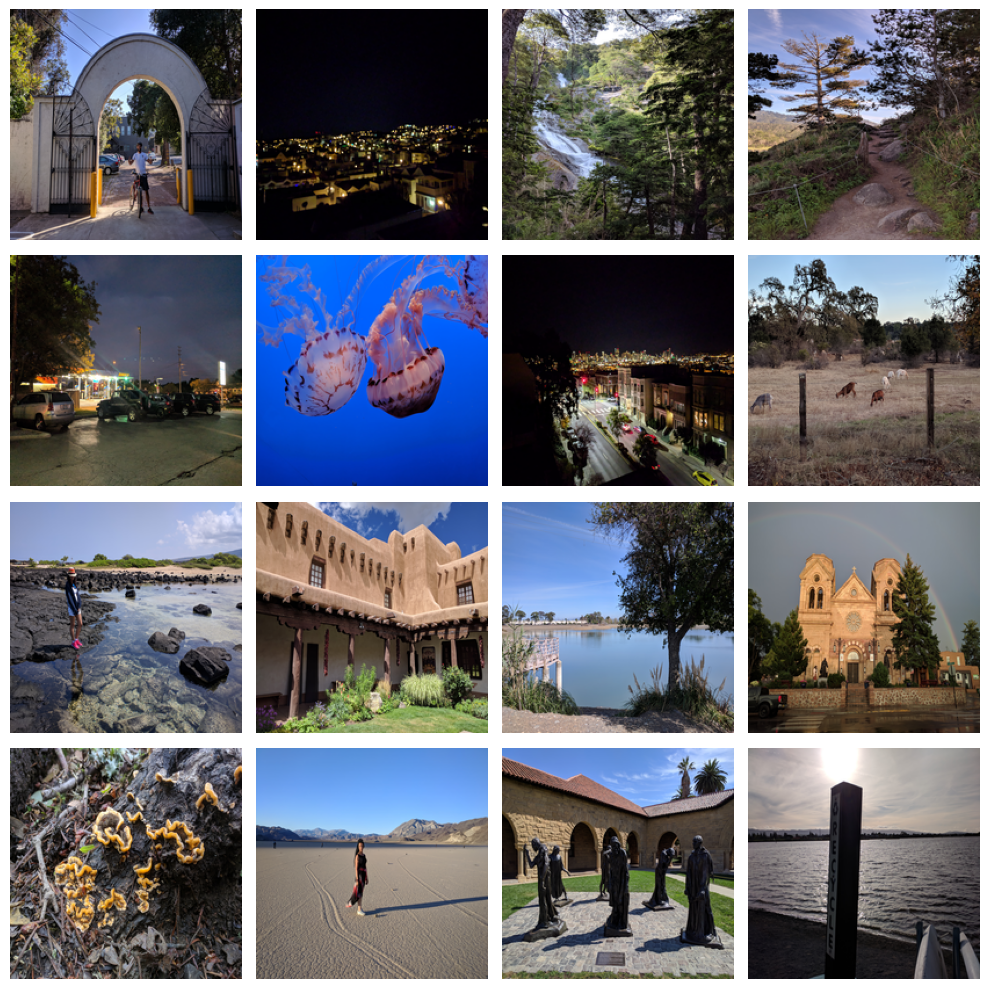

In [4]:
import os
import random
from PIL import Image
import matplotlib.pyplot as plt

# List to hold all image paths
all_image_paths = []

# Walk through the directory and its subdirectories to find all images
for root, dirs, files in os.walk(image_dir):
    for file in files:
        # Construct the full file path
        file_path = os.path.join(root, file)
        # Check if the file is an image
        if file_path.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tif', '.tiff')):
            all_image_paths.append(file_path)

# Randomly select 16 images
sample_images = random.sample(all_image_paths, 16) if len(all_image_paths) >= 16 else all_image_paths

# Create a 4x4 grid of images
fig, axes = plt.subplots(4, 4, figsize=(10, 10))
for ax, img_path in zip(axes.flatten(), sample_images):
    # Open and resize image
    img = Image.open(img_path)
    img = img.resize((200, 200), Image.ANTIALIAS)
    ax.imshow(img)
    ax.axis('off')  # Turn off axis

plt.tight_layout()
plt.show()


### **3D Color Distribution Plot**

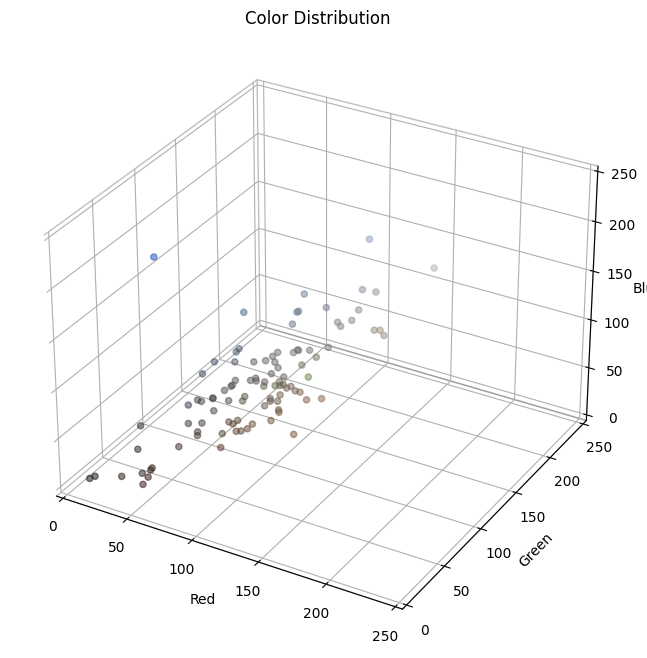

In [5]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from PIL import Image
import random

def plot_color_distribution(images):
    color_data = np.zeros((len(images), 3))  # For storing mean R, G, B values

    for i, img_path in enumerate(images):
        with Image.open(img_path) as img:
            img = img.resize((50, 50))  # Resize for faster processing
            img_data = np.array(img)
            mean_colors = img_data.mean(axis=(0, 1))  # Average over pixels and height, width
            color_data[i] = mean_colors

    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')  # Define a 3D projection
    scatter = ax.scatter(color_data[:, 0], color_data[:, 1], color_data[:, 2], c=color_data / 255, alpha=0.5)
    ax.set_xlabel('Red')
    ax.set_ylabel('Green')
    ax.set_zlabel('Blue')
    ax.set_title('Color Distribution')

    # Customizing the appearance 
    ax.grid(True)  # Enable the grid
    ax.set_xticks(range(0, 256, 50))  # Set x-ticks at intervals of 50
    ax.set_yticks(range(0, 256, 50))  # Set y-ticks at intervals of 50
    ax.set_zticks(range(0, 256, 50))  # Set z-ticks at intervals of 50
    ax.xaxis.pane.fill = False  # Disable filling the pane for x-axis
    ax.yaxis.pane.fill = False  # Disable filling the pane for y-axis
    ax.zaxis.pane.fill = False  # Disable filling the pane for z-axis
    ax.xaxis.pane.set_edgecolor('gray')  # Set pane edge color to gray for x-axis
    ax.yaxis.pane.set_edgecolor('gray')  # Set pane edge color to gray for y-axis
    ax.zaxis.pane.set_edgecolor('gray')  # Set pane edge color to gray for z-axis

    plt.show()

# Randomly select 100 images or less if there are not enough
sample_images = random.sample(all_image_paths, 100) if len(all_image_paths) >= 100 else all_image_paths
plot_color_distribution(sample_images)  # Sample 100 images for quick analysis


This graph is a 3D plot of the distribution of red, green, and blue (RGB) color intensities across the images in the HDR+ dataset. The axes represent the intensity values for each color channel:

Red intensity values are shown along the x-axis.
Green intensity values are shown along the y-axis.
Blue intensity values are plotted on the z-axis.
Each dot represents the color intensity of a pixel or a group of pixels in the dataset. By examining this plot, you can see the range and concentration of different colors present in your images. This information is helpful in understanding the diversity and quality of the dataset, especially in terms of color richness and balance.

This understanding is critical when deblurring images, as the effectiveness of your algorithm can vary with different color intensities and lighting conditions. Knowing the common color ranges can guide adjustments in your deblurring process to enhance the image quality more effectively.

### Intensity Histogram Plot for sample of 25 images

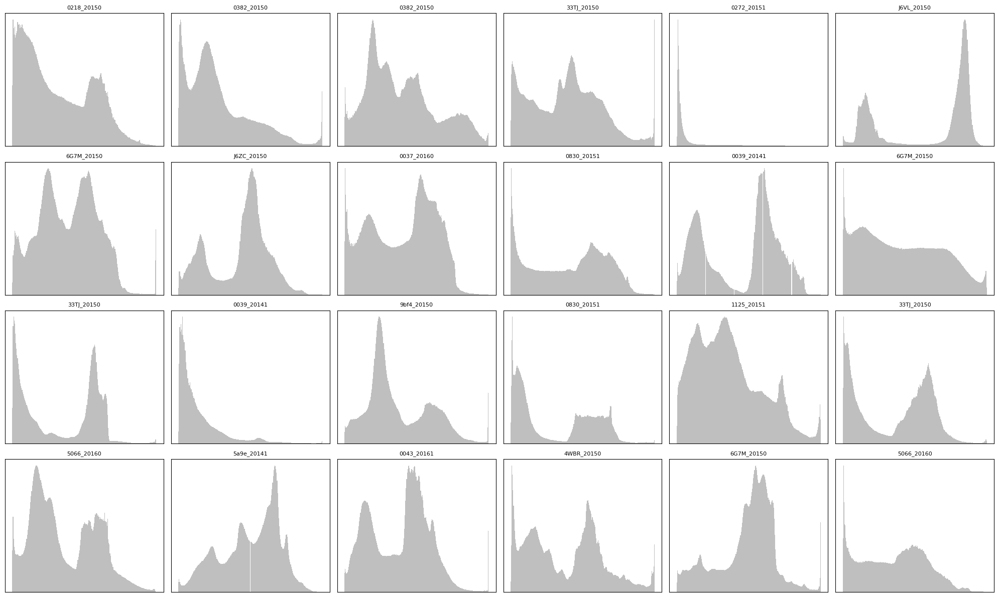

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import random
import os

def plot_intensity_histograms(images, sample_size=24):
    # Sample a subset of images to make the process manageable
    sampled_images = random.sample(images, min(sample_size, len(images)))
    fig, axes = plt.subplots(4, 6, figsize=(20, 12))  # Adjust grid size for 24 images
    axes = axes.ravel()

    for idx, img_path in enumerate(sampled_images):
        with Image.open(img_path).convert('L') as img:  # Convert to grayscale
            img_array = np.array(img)
            axes[idx].hist(img_array.ravel(), bins=256, color='gray', alpha=0.5)
            axes[idx].set_xticks([])
            axes[idx].set_yticks([])
            axes[idx].set_title(os.path.basename(img_path)[:10], fontsize=8)
        if idx == 23:  # Break the loop if 24 plots have been filled
            break

    # If there are fewer images than plots, turn off the extra axes
    for ax in axes[idx+1:]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# Call the function with the image paths
plot_intensity_histograms(all_image_paths)


Each histogram shows the distribution of pixel intensities within an individual image:

The x-axis of each histogram represents the intensity levels, ranging from 0 (black) to 255 (white).
The y-axis indicates the frequency of each intensity level in the image.
These histograms help in understanding the exposure and contrast characteristics of each image in the dataset. By analyzing these graphs, you can determine if the images tend to be underexposed (most pixel values are low), overexposed (most pixel values are high), or well-balanced.

### Image Contrast Distribution Chart

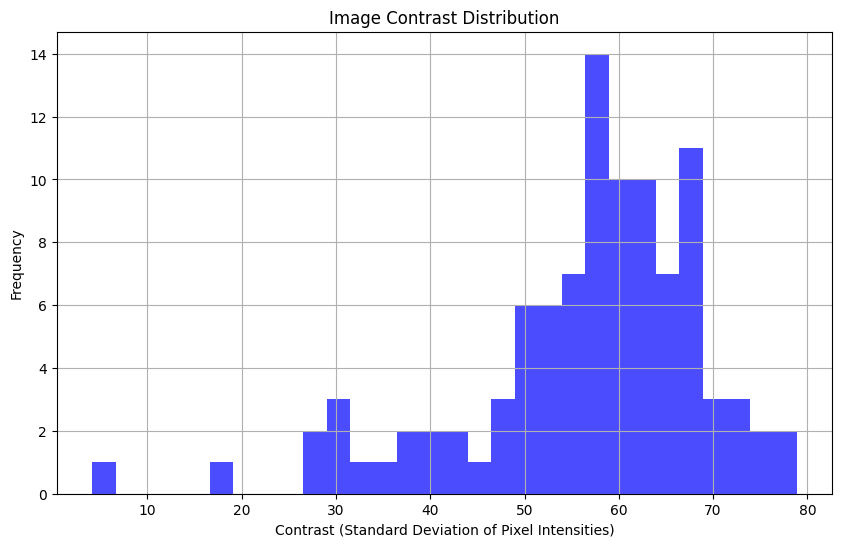

In [7]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import random

def plot_contrast_analysis(images, sample_size=100):
    # Sample a subset of images if there are more than sample_size images available
    sampled_images = random.sample(images, min(sample_size, len(images)))
    contrast_values = []

    for img_path in sampled_images:
        with Image.open(img_path).convert('L') as img:  # Convert to grayscale
            img_array = np.array(img)
            contrast = img_array.std()  # Standard deviation of pixel intensities
            contrast_values.append(contrast)

    plt.figure(figsize=(10, 6))
    plt.hist(contrast_values, bins=30, color='blue', alpha=0.7)
    plt.title('Image Contrast Distribution')
    plt.xlabel('Contrast (Standard Deviation of Pixel Intensities)')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

# Call the function with the image paths
plot_contrast_analysis(all_image_paths)


The x-axis shows the contrast levels, and the y-axis represents the frequency of images with those contrast levels.

A higher standard deviation indicates greater contrast within an image, while a lower standard deviation suggests less contrast. From the histogram, it is evident that the majority of images have moderate contrast levels, peaking around 40-50. There are fewer images with very low or very high contrast.

### Average Local Binary Pattern (LBP) distribution

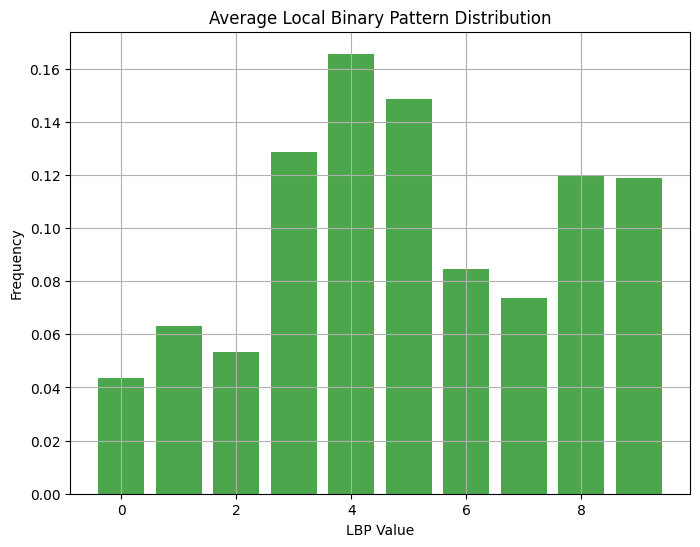

In [8]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import random
from skimage import feature  # Ensure skimage is installed

def plot_lbp_distribution(images, sample_size=50):
    sampled_images = random.sample(images, min(sample_size, len(images)))
    lbp_values = []

    for img_path in sampled_images:
        with Image.open(img_path).convert('L') as img:  # Convert to grayscale
            img_array = np.array(img)
            # Calculate the Local Binary Pattern representation
            lbp = feature.local_binary_pattern(img_array, P=8, R=1, method='uniform')
            # Compute the histogram of LBP
            lbp_hist, _ = np.histogram(lbp.ravel(), bins=np.arange(0, 11), density=True)
            lbp_values.append(lbp_hist)

    lbp_values = np.array(lbp_values)
    avg_lbp = lbp_values.mean(axis=0)
    plt.figure(figsize=(8, 6))
    plt.bar(np.arange(10), avg_lbp, color='green', alpha=0.7)
    plt.title('Average Local Binary Pattern Distribution')
    plt.xlabel('LBP Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

# Call the function with the image paths
plot_lbp_distribution(all_image_paths)


LBP is a texture descriptor that measures the local contrast of an image and is useful for texture classification.

The x-axis represents different LBP values, which are calculated based on the binary patterns formed by the pixels in the neighborhood of each central pixel.
The y-axis shows the frequency of these LBP values across all analyzed images.
From the histogram, we say that LBP values around 4 and 6 are most common, which tells that these images typically have moderate to high local contrast and textural variation. Images with higher or lower LBP values are less frequent.

### Outlier Detection Based on the Contrast

Total number of outliers: 169


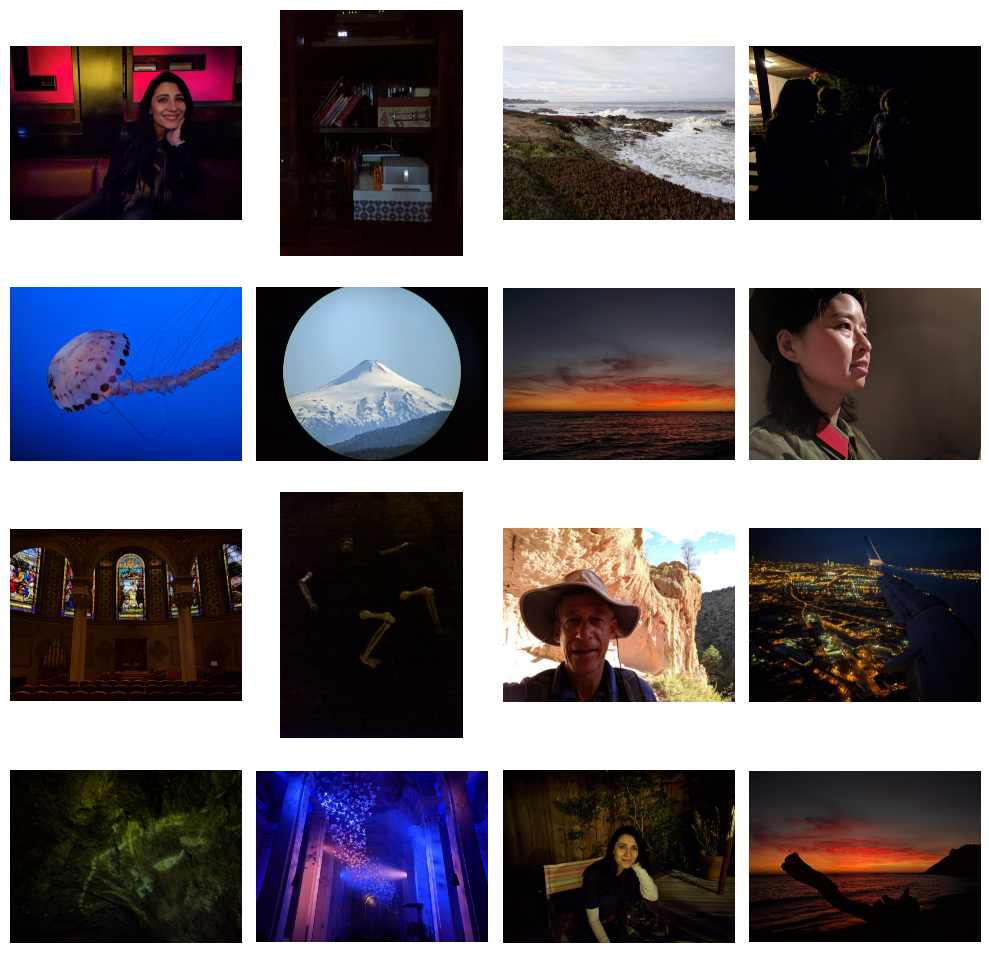

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import random

def calculate_contrast(images):
    contrast_values = []
    image_paths = []

    for img_path in images:
        with Image.open(img_path).convert('L') as img:  # Convert to grayscale
            img_array = np.array(img)
            contrast = img_array.std()  # Standard deviation of pixel intensities
            contrast_values.append(contrast)
            image_paths.append(img_path)

    return contrast_values, image_paths

def identify_and_display_outliers(image_paths, contrast_values, threshold=2):
    # Calculate mean and standard deviation
    mean_contrast = np.mean(contrast_values)
    std_contrast = np.std(contrast_values)

    # Finding outliers: more than 'threshold' standard deviations from the mean
    outliers = [path for path, contrast in zip(image_paths, contrast_values) if abs(contrast - mean_contrast) > threshold * std_contrast]

    print(f"Total number of outliers: {len(outliers)}")

    # Display a sample of 16 outliers in a 4x4 grid
    if len(outliers) > 16:
        sampled_outliers = random.sample(outliers, 16)
    else:
        sampled_outliers = outliers

    fig, axes = plt.subplots(4, 4, figsize=(10, 10))
    for ax, img_path in zip(axes.flatten(), sampled_outliers):
        with Image.open(img_path) as img:
            ax.imshow(img)
            ax.axis('off')  # Turn off axis

    plt.tight_layout()
    plt.show()

# Calculate contrast for all images
contrasts, paths = calculate_contrast(all_image_paths)
# Identify and display outliers
identify_and_display_outliers(paths, contrasts)


There were total 169 outliers identified based on the contrast and output shows a sample of it

### Preparing Dataset to apply models

In [10]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageFilter
import random

def preprocess_and_display_images(image_paths, sample_size=200):
    # Sample images
    sampled_paths = random.sample(image_paths, min(sample_size, len(image_paths)))
    processed_images = []

    for img_path in sampled_paths:
        # Open and resize the image
        img = Image.open(img_path).resize((200, 200))

        # Apply Gaussian blur
        blurred = img.filter(ImageFilter.GaussianBlur(radius=1))

        # Convert to numpy array to add noise
        img_array = np.array(blurred, dtype=np.float32)

        # Generate noise and add it to the image
        noise = np.random.normal(0, 10, img_array.shape)
        noisy_image = np.clip(img_array + noise, 0, 255).astype(np.uint8)

        # Convert back to PIL image
        noisy_image_pil = Image.fromarray(noisy_image)

        # Store both original and processed images
        processed_images.append((img, noisy_image_pil))

    # Display sample of 4 images
    fig, axes = plt.subplots(2, 4, figsize=(12, 6))  # 2 rows, 4 columns
    titles = ['Original', 'Gaussian Blur + Noise']
    for idx, (orig, proc) in enumerate(processed_images[:4]):
        axes[0, idx].imshow(orig)
        axes[0, idx].set_title('Original')
        axes[0, idx].axis('off')

        axes[1, idx].imshow(proc)
        axes[1, idx].set_title('Gaussian Blur + Noise')
        axes[1, idx].axis('off')

    plt.tight_layout()
    plt.show()
    return processed_images



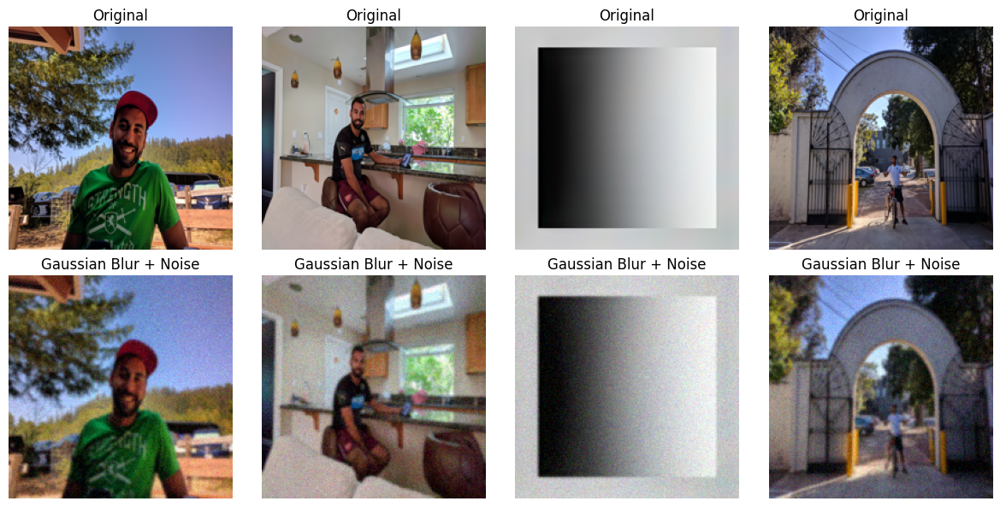

[(<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Ima

In [11]:
# Call the function with the image paths
preprocess_and_display_images(all_image_paths)

### Applying CNN on HDR+ Dataset (Sample Size = 200)

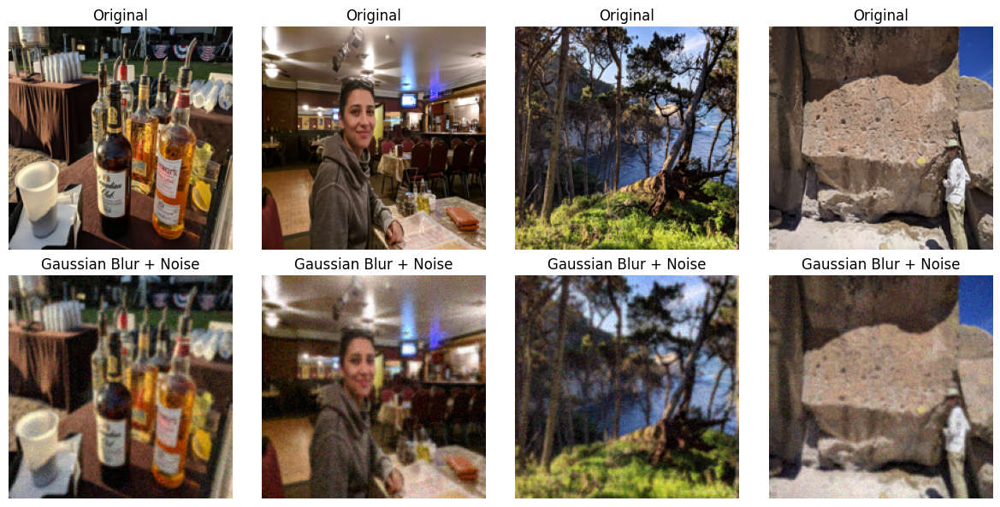

In [12]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageFilter
import random
from skimage.metrics import peak_signal_noise_ratio, structural_similarity
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D
import cv2

# Define function to build CNN model
def build_cnn_model(input_shape):
    inputs = Input(shape=input_shape)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(inputs)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    encoded = MaxPooling2D((2, 2), padding='same')(x)

    # at this point the representation is (56, 56, 32)

    x = Conv2D(32, (3, 3), activation='relu', padding='same')(encoded)
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)
    decoded = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)

    cnn_model = Model(inputs, decoded)
    cnn_model.compile(optimizer='adam', loss='mse', metrics=['accuracy'])
    return cnn_model

# Define function to calculate PSNR and SSIM values
def calculate_metrics(original, noisy, denoised):
    psnr_noisy = peak_signal_noise_ratio(original, noisy)
    ssim_noisy = structural_similarity(original, noisy, multichannel=True)

    psnr_denoised = peak_signal_noise_ratio(original, denoised)
    ssim_denoised = structural_similarity(original, denoised, multichannel=True)

    return psnr_noisy, ssim_noisy, psnr_denoised, ssim_denoised

# Call the function with the image paths
processed_images = preprocess_and_display_images(all_image_paths)

In [13]:
processed_images

[(<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Image.Image image mode=RGB size=200x200>,
  <PIL.Image.Image image mode=RGB size=200x200>),
 (<PIL.Ima

In [14]:
# Extract original and noisy images from processed_images
original_images = [pair[0] for pair in processed_images]
noisy_images = [pair[1] for pair in processed_images]

# Convert original_images and noisy_images to numpy arrays
original_images = np.array([np.array(img) for img in original_images])
noisy_images = np.array([np.array(img) for img in noisy_images])

# Normalize original_images and noisy_images
original_images = original_images.astype('float32') / 255.0
noisy_images = noisy_images.astype('float32') / 255.0

# Build and train the CNN model
input_shape = (200, 200, 3)  # Adjust input shape according to your images
cnn_model = build_cnn_model(input_shape)
cnn_history = cnn_model.fit(noisy_images, original_images, epochs=10, batch_size=20, validation_split=0.2)

# Deblur the images using the trained CNN model
denoised_images = cnn_model.predict(noisy_images)

Epoch 1/10
8/8 [==============================] - 5s 56ms/step - loss: 0.0804 - accuracy: 0.2900 - val_loss: 0.0726 - val_accuracy: 0.4464
Epoch 2/10
8/8 [==============================] - 0s 22ms/step - loss: 0.0590 - accuracy: 0.6127 - val_loss: 0.0393 - val_accuracy: 0.6911
Epoch 3/10
8/8 [==============================] - 0s 22ms/step - loss: 0.0281 - accuracy: 0.6854 - val_loss: 0.0247 - val_accuracy: 0.7023
Epoch 4/10
8/8 [==============================] - 0s 21ms/step - loss: 0.0205 - accuracy: 0.7226 - val_loss: 0.0166 - val_accuracy: 0.7220
Epoch 5/10
8/8 [==============================] - 0s 21ms/step - loss: 0.0154 - accuracy: 0.7607 - val_loss: 0.0127 - val_accuracy: 0.7168
Epoch 6/10
8/8 [==============================] - 0s 22ms/step - loss: 0.0130 - accuracy: 0.7630 - val_loss: 0.0104 - val_accuracy: 0.7776
Epoch 7/10
8/8 [==============================] - 0s 22ms/step - loss: 0.0115 - accuracy: 0.7959 - val_loss: 0.0103 - val_accuracy: 0.7637
Epoch 8/10
8/8 [===========

**PSNR and SSIM Values for Blurred and Deblurred Images (Sample: 200)**

In [15]:
# Calculate PSNR and SSIM values before and after denoising
psnr_values = []
ssim_values = []
for i in range(len(original_images)):
    psnr_noisy, ssim_noisy, psnr_denoised, ssim_denoised = calculate_metrics(original_images[i], noisy_images[i], denoised_images[i])
    psnr_values.append((psnr_noisy, psnr_denoised))
    ssim_values.append((ssim_noisy, ssim_denoised))

# Print PSNR and SSIM values
for i, (psnr_noisy, psnr_denoised) in enumerate(psnr_values):
    print(f"Image {i+1} - PSNR (Noisy): {psnr_noisy:.2f}, PSNR (Denoised): {psnr_denoised:.2f}")

for i, (ssim_noisy, ssim_denoised) in enumerate(ssim_values):
    print(f"Image {i+1} - SSIM (Noisy): {ssim_noisy:.2f}, SSIM (Denoised): {ssim_denoised:.2f}")



<ipython-input-12-6654e1c0fbc0>:33: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_noisy = structural_similarity(original, noisy, multichannel=True)
<ipython-input-12-6654e1c0fbc0>:36: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_denoised = structural_similarity(original, denoised, multichannel=True)


Image 1 - PSNR (Noisy): 23.03, PSNR (Denoised): 18.68
Image 2 - PSNR (Noisy): 24.46, PSNR (Denoised): 20.09
Image 3 - PSNR (Noisy): 21.77, PSNR (Denoised): 17.76
Image 4 - PSNR (Noisy): 24.80, PSNR (Denoised): 21.44
Image 5 - PSNR (Noisy): 24.13, PSNR (Denoised): 20.45
Image 6 - PSNR (Noisy): 24.11, PSNR (Denoised): 19.55
Image 7 - PSNR (Noisy): 24.38, PSNR (Denoised): 20.08
Image 8 - PSNR (Noisy): 23.23, PSNR (Denoised): 18.99
Image 9 - PSNR (Noisy): 22.87, PSNR (Denoised): 19.20
Image 10 - PSNR (Noisy): 23.77, PSNR (Denoised): 19.40
Image 11 - PSNR (Noisy): 25.31, PSNR (Denoised): 20.99
Image 12 - PSNR (Noisy): 28.16, PSNR (Denoised): 24.33
Image 13 - PSNR (Noisy): 25.48, PSNR (Denoised): 21.28
Image 14 - PSNR (Noisy): 26.39, PSNR (Denoised): 22.76
Image 15 - PSNR (Noisy): 23.74, PSNR (Denoised): 20.08
Image 16 - PSNR (Noisy): 23.02, PSNR (Denoised): 19.21
Image 17 - PSNR (Noisy): 27.07, PSNR (Denoised): 23.43
Image 18 - PSNR (Noisy): 22.90, PSNR (Denoised): 19.46
Image 19 - PSNR (No

**Training and Validation Loss**

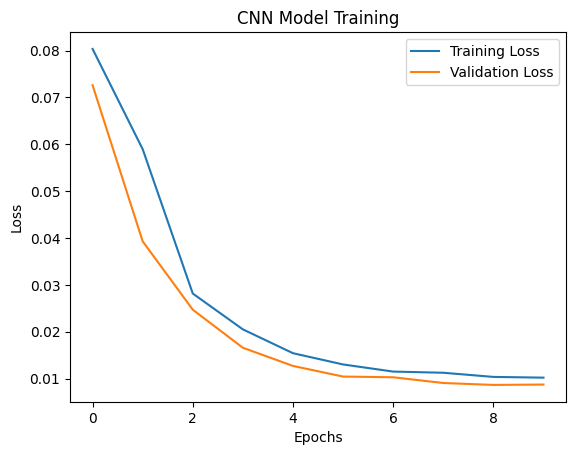

In [16]:
# Plot the training history
plt.plot(cnn_history.history['loss'], label='Training Loss')
plt.plot(cnn_history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('CNN Model Training')
plt.legend()
plt.show()

**Results of CNN**

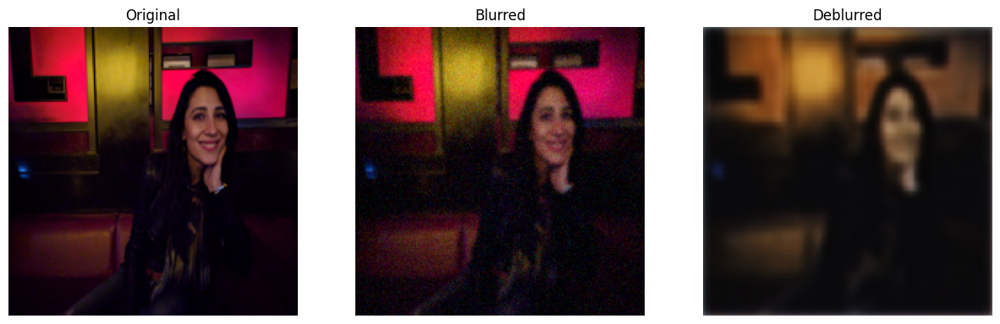

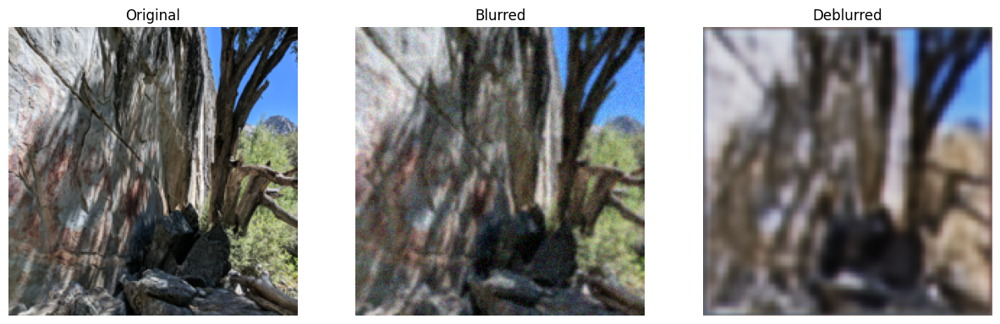

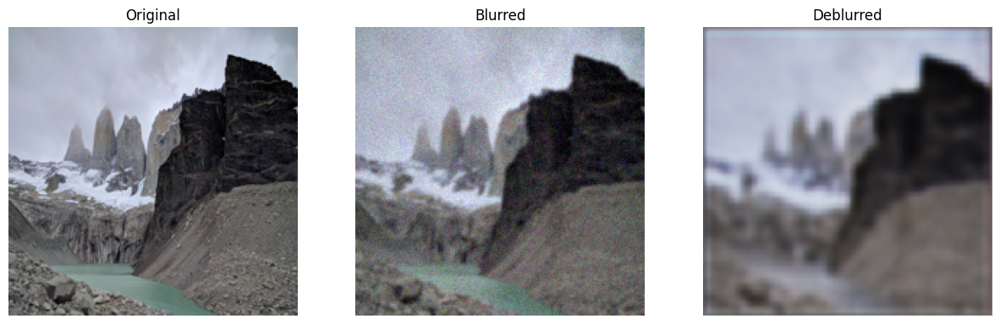

In [17]:
# Choose 3 random samples
sample_indices = random.sample(range(len(original_images)), 3)

# Plot original, noisy, and denoised images for selected samples
for i in sample_indices:
    plt.figure(figsize=(15, 5))

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(original_images[i])
    plt.title('Original')
    plt.axis('off')

    # Noisy image
    plt.subplot(1, 3, 2)
    plt.imshow(noisy_images[i])
    plt.title('Blurred')
    plt.axis('off')

    # Denoised image
    plt.subplot(1, 3, 3)
    plt.imshow(denoised_images[i])
    plt.title('Deblurred')
    plt.axis('off')

    plt.show()

We can say the model did somewhat fine job of removing the noise but was not able to handle the blur very well.

### Applying U-NET on HDR+ Dataset (Sample Size = 200)

In [18]:
def build_unet_model(input_shape):
    inputs = Input(shape=input_shape)

    # Encoder
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, 3, activation='relu', padding='same')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    # Middle
    conv3 = Conv2D(256, 3, activation='relu', padding='same')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same')(conv3)

    # Decoder
    up1 = Concatenate()([UpSampling2D(size=(2, 2))(conv3), conv2])
    conv4 = Conv2D(128, 3, activation='relu', padding='same')(up1)
    conv4 = Conv2D(128, 3, activation='relu', padding='same')(conv4)

    up2 = Concatenate()([UpSampling2D(size=(2, 2))(conv4), conv1])
    conv5 = Conv2D(64, 3, activation='relu', padding='same')(up2)
    conv5 = Conv2D(64, 3, activation='relu', padding='same')(conv5)

    # Output
    outputs = Conv2D(3, 3, activation='sigmoid', padding='same')(conv5)

    model = Model(inputs=inputs, outputs=outputs)
    model.compile(optimizer='adam', loss='mse', metrics=['accuracy'])
    return model

In [19]:
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Concatenate
from tensorflow.keras.models import Model

# Build and train the Unet model
input_shape = (200, 200, 3)  #
unet_model = build_unet_model(input_shape)
unet_history = unet_model.fit(noisy_images, original_images, epochs=10, batch_size=20, validation_split=0.2)


# Deblur the images using the trained unet_model model
denoised_images = unet_model.predict(noisy_images)


Epoch 1/10
8/8 [==============================] - 10s 186ms/step - loss: 0.0802 - accuracy: 0.5240 - val_loss: 0.0578 - val_accuracy: 0.6321
Epoch 2/10
8/8 [==============================] - 1s 150ms/step - loss: 0.0421 - accuracy: 0.6224 - val_loss: 0.0350 - val_accuracy: 0.3643
Epoch 3/10
8/8 [==============================] - 1s 150ms/step - loss: 0.0238 - accuracy: 0.4406 - val_loss: 0.0322 - val_accuracy: 0.6208
Epoch 4/10
8/8 [==============================] - 1s 151ms/step - loss: 0.0224 - accuracy: 0.6435 - val_loss: 0.0163 - val_accuracy: 0.6771
Epoch 5/10
8/8 [==============================] - 1s 151ms/step - loss: 0.0157 - accuracy: 0.6657 - val_loss: 0.0125 - val_accuracy: 0.7087
Epoch 6/10
8/8 [==============================] - 1s 151ms/step - loss: 0.0110 - accuracy: 0.7531 - val_loss: 0.0078 - val_accuracy: 0.7629
Epoch 7/10
8/8 [==============================] - 1s 151ms/step - loss: 0.0080 - accuracy: 0.7967 - val_loss: 0.0065 - val_accuracy: 0.7652
Epoch 8/10
8/8 [===

**PSNR and SSIM Values for Blurred and Deblurred Images (Sample: 200)**

In [20]:
# Calculate PSNR and SSIM values before and after denoising
psnr_values = []
ssim_values = []
for i in range(len(original_images)):
    psnr_noisy, ssim_noisy, psnr_denoised, ssim_denoised = calculate_metrics(original_images[i], noisy_images[i], denoised_images[i])
    psnr_values.append((psnr_noisy, psnr_denoised))
    ssim_values.append((ssim_noisy, ssim_denoised))

# Print PSNR and SSIM values
for i, (psnr_noisy, psnr_denoised) in enumerate(psnr_values):
    print(f"Image {i+1} - PSNR (Noisy): {psnr_noisy:.2f}, PSNR (Denoised): {psnr_denoised:.2f}")

for i, (ssim_noisy, ssim_denoised) in enumerate(ssim_values):
    print(f"Image {i+1} - SSIM (Noisy): {ssim_noisy:.2f}, SSIM (Denoised): {ssim_denoised:.2f}")


<ipython-input-12-6654e1c0fbc0>:33: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_noisy = structural_similarity(original, noisy, multichannel=True)
<ipython-input-12-6654e1c0fbc0>:36: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_denoised = structural_similarity(original, denoised, multichannel=True)


Image 1 - PSNR (Noisy): 23.03, PSNR (Denoised): 21.50
Image 2 - PSNR (Noisy): 24.46, PSNR (Denoised): 23.28
Image 3 - PSNR (Noisy): 21.77, PSNR (Denoised): 20.06
Image 4 - PSNR (Noisy): 24.80, PSNR (Denoised): 24.65
Image 5 - PSNR (Noisy): 24.13, PSNR (Denoised): 22.76
Image 6 - PSNR (Noisy): 24.11, PSNR (Denoised): 22.56
Image 7 - PSNR (Noisy): 24.38, PSNR (Denoised): 23.37
Image 8 - PSNR (Noisy): 23.23, PSNR (Denoised): 21.52
Image 9 - PSNR (Noisy): 22.87, PSNR (Denoised): 21.35
Image 10 - PSNR (Noisy): 23.77, PSNR (Denoised): 22.31
Image 11 - PSNR (Noisy): 25.31, PSNR (Denoised): 24.34
Image 12 - PSNR (Noisy): 28.16, PSNR (Denoised): 27.75
Image 13 - PSNR (Noisy): 25.48, PSNR (Denoised): 24.10
Image 14 - PSNR (Noisy): 26.39, PSNR (Denoised): 26.64
Image 15 - PSNR (Noisy): 23.74, PSNR (Denoised): 22.62
Image 16 - PSNR (Noisy): 23.02, PSNR (Denoised): 21.88
Image 17 - PSNR (Noisy): 27.07, PSNR (Denoised): 26.40
Image 18 - PSNR (Noisy): 22.90, PSNR (Denoised): 21.46
Image 19 - PSNR (No

**Training History**

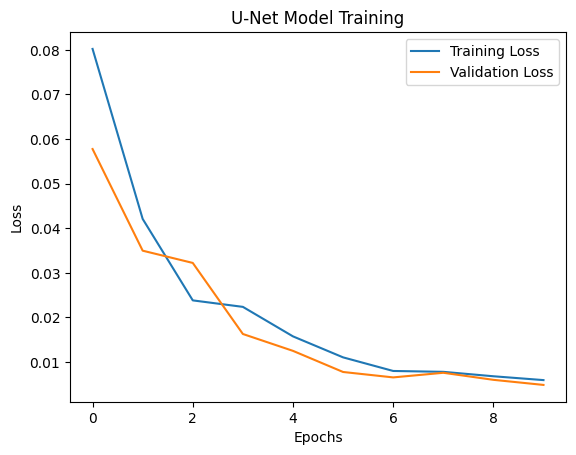

In [21]:
# Plot the training history
plt.plot(unet_history.history['loss'], label='Training Loss')
plt.plot(unet_history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('U-Net Model Training')
plt.legend()
plt.show()

**Results for U-Net**

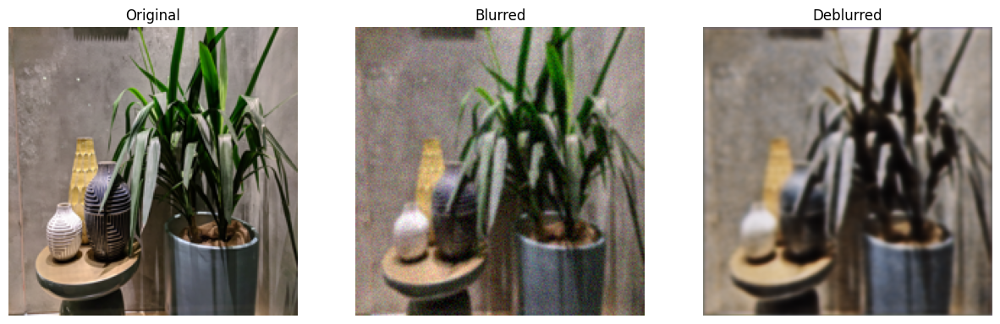

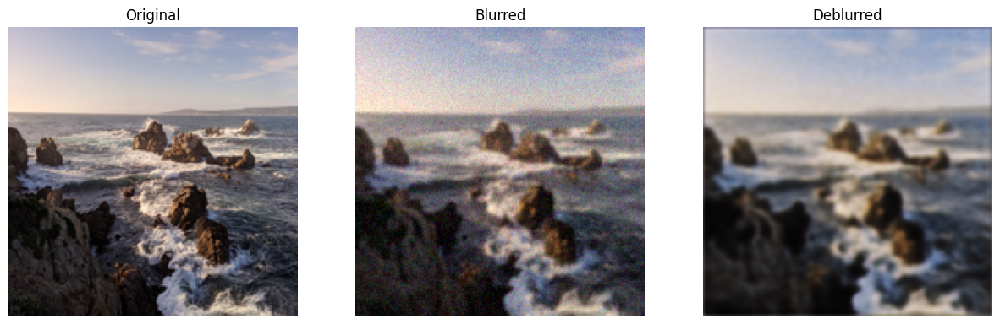

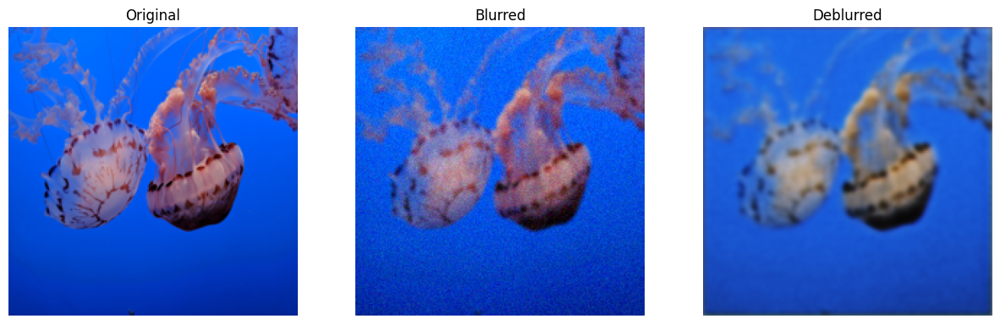

In [22]:
# Choose 3 random samples
sample_indices = random.sample(range(len(original_images)), 3)

# Plot original, noisy, and denoised images for selected samples
for i in sample_indices:
    plt.figure(figsize=(15, 5))

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(original_images[i])
    plt.title('Original')
    plt.axis('off')

    # Noisy image
    plt.subplot(1, 3, 2)
    plt.imshow(noisy_images[i])
    plt.title('Blurred')
    plt.axis('off')

    # Denoised image
    plt.subplot(1, 3, 3)
    plt.imshow(denoised_images[i])
    plt.title('Deblurred')
    plt.axis('off')

    plt.show()

It can be inferred by the results that even tho the alogrithm performed well as soon from the Training graph, we can see by the SSIM and PSNR scores that the model performed worse than CNN in generating the deblurred images

### Auto Encoder on HDR+ Dataset (Sample Size = 200)

In [23]:
def build_autoencoder(input_shape):
    inputs = Input(shape=input_shape)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(inputs)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    encoded = MaxPooling2D((2, 2), padding='same')(x)

    # at this point the representation is (56, 56, 32)

    x = Conv2D(32, (3, 3), activation='relu', padding='same')(encoded)
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)
    decoded = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)

    autoencoder = Model(inputs, decoded)
    autoencoder.compile(optimizer='adam', loss='mse', metrics=['accuracy'])
    return autoencoder

In [24]:
# Build and train the autoencoder model
input_shape = (200, 200, 3)
autoencoder_model = build_autoencoder(input_shape)
autoencoder_history = autoencoder_model.fit(noisy_images, original_images, epochs=5, batch_size=20, validation_split=0.2)

# Deblur the images using the trained autoencoder_history model
denoised_images = autoencoder_model.predict(noisy_images)


Epoch 1/5
8/8 [==============================] - 2s 45ms/step - loss: 0.0791 - accuracy: 0.3607 - val_loss: 0.0711 - val_accuracy: 0.4529
Epoch 2/5
8/8 [==============================] - 0s 20ms/step - loss: 0.0545 - accuracy: 0.5411 - val_loss: 0.0330 - val_accuracy: 0.6837
Epoch 3/5
8/8 [==============================] - 0s 21ms/step - loss: 0.0248 - accuracy: 0.6782 - val_loss: 0.0204 - val_accuracy: 0.7039
Epoch 4/5
8/8 [==============================] - 0s 22ms/step - loss: 0.0166 - accuracy: 0.7104 - val_loss: 0.0128 - val_accuracy: 0.7274
Epoch 5/5
7/7 [==============================] - 0s 10ms/step


**PSNR and SSIM Values for Blurred and Deblurred Images (Sample: 200)**

In [25]:
# Calculate PSNR and SSIM values before and after denoising
psnr_values = []
ssim_values = []
for i in range(len(original_images)):
    psnr_noisy, ssim_noisy, psnr_denoised, ssim_denoised = calculate_metrics(original_images[i], noisy_images[i], denoised_images[i])
    psnr_values.append((psnr_noisy, psnr_denoised))
    ssim_values.append((ssim_noisy, ssim_denoised))

# Print PSNR and SSIM values
for i, (psnr_noisy, psnr_denoised) in enumerate(psnr_values):
    print(f"Image {i+1} - PSNR (Noisy): {psnr_noisy:.2f}, PSNR (Denoised): {psnr_denoised:.2f}")

for i, (ssim_noisy, ssim_denoised) in enumerate(ssim_values):
    print(f"Image {i+1} - SSIM (Noisy): {ssim_noisy:.2f}, SSIM (Denoised): {ssim_denoised:.2f}")

# Calculate average PSNR and SSIM values before denoising
total_psnr_noisy = sum(psnr_noisy for psnr_noisy, _ in psnr_values) / len(psnr_values)
total_ssim_noisy = sum(ssim_noisy for ssim_noisy, _ in ssim_values) / len(ssim_values)

print(f"Average PSNR (Noisy): {total_psnr_noisy:.2f}")
print(f"Average SSIM (Noisy): {total_ssim_noisy:.2f}")

# Calculate average PSNR and SSIM values after denoising
total_psnr_denoised = sum(psnr_denoised for _, psnr_denoised in psnr_values) / len(psnr_values)
total_ssim_denoised = sum(ssim_denoised for _, ssim_denoised in ssim_values) / len(ssim_values)

print(f"Average PSNR (Denoised): {total_psnr_denoised:.2f}")
print(f"Average SSIM (Denoised): {total_ssim_denoised:.2f}")




<ipython-input-12-6654e1c0fbc0>:33: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_noisy = structural_similarity(original, noisy, multichannel=True)
<ipython-input-12-6654e1c0fbc0>:36: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_denoised = structural_similarity(original, denoised, multichannel=True)


Image 1 - PSNR (Noisy): 23.03, PSNR (Denoised): 17.92
Image 2 - PSNR (Noisy): 24.46, PSNR (Denoised): 19.12
Image 3 - PSNR (Noisy): 21.77, PSNR (Denoised): 17.06
Image 4 - PSNR (Noisy): 24.80, PSNR (Denoised): 20.17
Image 5 - PSNR (Noisy): 24.13, PSNR (Denoised): 19.35
Image 6 - PSNR (Noisy): 24.11, PSNR (Denoised): 18.24
Image 7 - PSNR (Noisy): 24.38, PSNR (Denoised): 19.02
Image 8 - PSNR (Noisy): 23.23, PSNR (Denoised): 18.31
Image 9 - PSNR (Noisy): 22.87, PSNR (Denoised): 18.60
Image 10 - PSNR (Noisy): 23.77, PSNR (Denoised): 18.48
Image 11 - PSNR (Noisy): 25.31, PSNR (Denoised): 20.26
Image 12 - PSNR (Noisy): 28.16, PSNR (Denoised): 23.23
Image 13 - PSNR (Noisy): 25.48, PSNR (Denoised): 20.12
Image 14 - PSNR (Noisy): 26.39, PSNR (Denoised): 20.86
Image 15 - PSNR (Noisy): 23.74, PSNR (Denoised): 19.75
Image 16 - PSNR (Noisy): 23.02, PSNR (Denoised): 18.50
Image 17 - PSNR (Noisy): 27.07, PSNR (Denoised): 22.25
Image 18 - PSNR (Noisy): 22.90, PSNR (Denoised): 18.87
Image 19 - PSNR (No

**Training History**

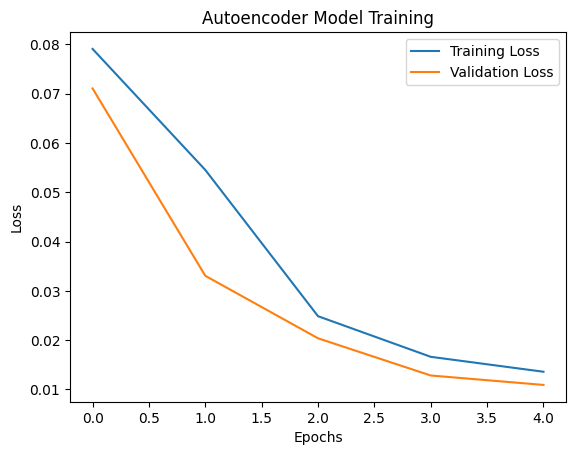

In [26]:
# Plot the training history
plt.plot(autoencoder_history.history['loss'], label='Training Loss')
plt.plot(autoencoder_history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Autoencoder Model Training')
plt.legend()
plt.show()

**Results for AutoEncoder**

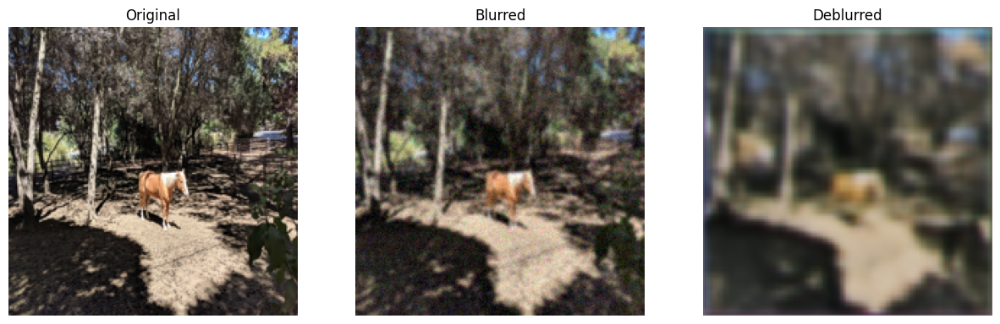

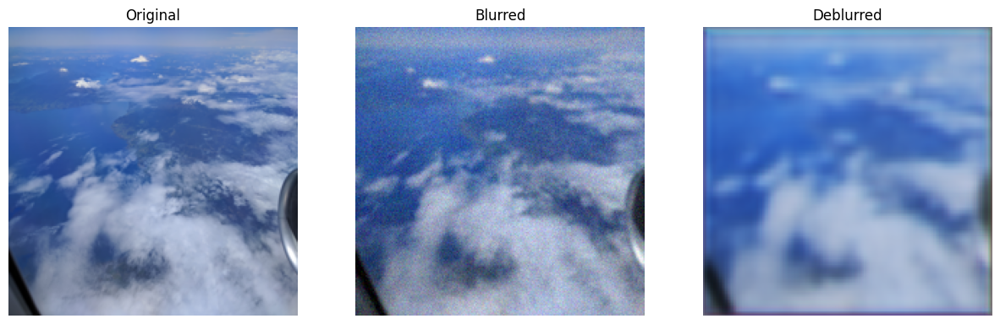

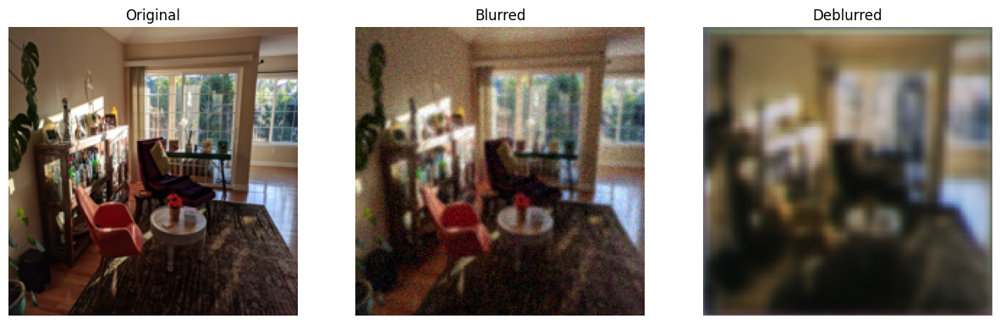

In [27]:
# Choose 3 random samples
sample_indices = random.sample(range(len(original_images)), 3)

# Plot original, noisy, and denoised images for selected samples
for i in sample_indices:
    plt.figure(figsize=(15, 5))

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(original_images[i])
    plt.title('Original')
    plt.axis('off')

    # Noisy image
    plt.subplot(1, 3, 2)
    plt.imshow(noisy_images[i])
    plt.title('Blurred')
    plt.axis('off')

    # Denoised image
    plt.subplot(1, 3, 3)
    plt.imshow(denoised_images[i])
    plt.title('Deblurred')
    plt.axis('off')

    plt.show()

It can be inferred by the results that the model performed worse than CNN as well as AutoEncoder in generating the deblurred images

## **Importing the ExDark Dataset**

In [28]:
import zipfile
import os

# Navigate through the directory structure and gather image paths
all_images = {}
exdark_path='/content/drive/My Drive/extracted_folders/ExDark/'
if os.path.isdir(exdark_path):
  # Look for categories directly within ExDark folder
  categories_path = exdark_path
  print(f"Categories path: {categories_path}")
  if os.path.isdir(categories_path):
    for category_name in os.listdir(categories_path):
      category_path = os.path.join(categories_path, category_name)
      print(f"Category: {category_name} | Category Path: {category_path}")
      if os.path.isdir(category_path):
        image_files = [os.path.join(category_path, f) for f in os.listdir(category_path) if f.endswith(('.png', '.jpg', '.jpeg'))]
        # Store the image files in the dictionary with category_name as key
        all_images[category_name] = image_files

Categories path: /content/drive/My Drive/extracted_folders/ExDark/
Category: Cat | Category Path: /content/drive/My Drive/extracted_folders/ExDark/Cat
Category: Car | Category Path: /content/drive/My Drive/extracted_folders/ExDark/Car
Category: Cup | Category Path: /content/drive/My Drive/extracted_folders/ExDark/Cup
Category: Dog | Category Path: /content/drive/My Drive/extracted_folders/ExDark/Dog
Category: Boat | Category Path: /content/drive/My Drive/extracted_folders/ExDark/Boat
Category: Chair | Category Path: /content/drive/My Drive/extracted_folders/ExDark/Chair
Category: Bus | Category Path: /content/drive/My Drive/extracted_folders/ExDark/Bus
Category: Motorbike | Category Path: /content/drive/My Drive/extracted_folders/ExDark/Motorbike
Category: Table | Category Path: /content/drive/My Drive/extracted_folders/ExDark/Table
Category: People | Category Path: /content/drive/My Drive/extracted_folders/ExDark/People
Category: Bicycle | Category Path: /content/drive/My Drive/extrac

## Exploratory Data Analysis for ExDark Dataset

**Color Mode Distribution Plot**

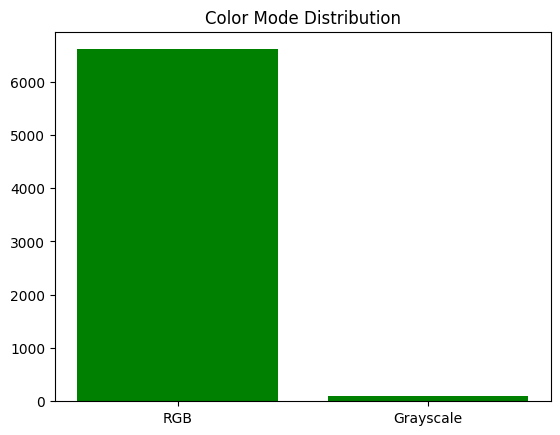

In [33]:
from PIL import Image

color_mode_count = {'RGB': 0, 'Grayscale': 0}

for folder_name, images in all_images.items():
    for img_path in images:
        with Image.open(img_path) as img:
            if img.mode == 'RGB':
                color_mode_count['RGB'] += 1
            else:
                color_mode_count['Grayscale'] += 1

plt.bar(color_mode_count.keys(), color_mode_count.values(), color='green')
plt.title('Color Mode Distribution')
plt.show()

Majority of the images are in RGB

**Pixel Intensity Distribution**

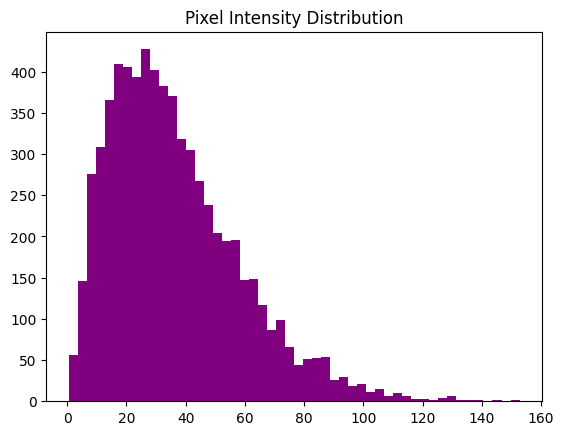

In [34]:
intensities = []

for folder_name, images in all_images.items():
    for img_path in images:
        with Image.open(img_path) as img:
            img_array = np.array(img)
            intensities.append(img_array.mean())

plt.hist(intensities, bins=50, color='purple')
plt.title('Pixel Intensity Distribution')
plt.show()

The x-axis represents pixel intensity values, ranging from 0 (black) to 160. The usual range up to 255 is compressed, indicating possibly rescaled or adjusted intensity values.
The y-axis measures the frequency of each intensity value across the image.
The distribution is skewed towards the darker end, peaking at lower intensity values around 20-40, and then tapering off as intensities increase. This suggests that the image is predominantly dark, which is typical for low-light images.

**Outlier Detection**

Total number of outlier images: 0
Outliers are considered as such because their dimensions fall outside of the typical range defined by the mean ± 2 standard deviations.


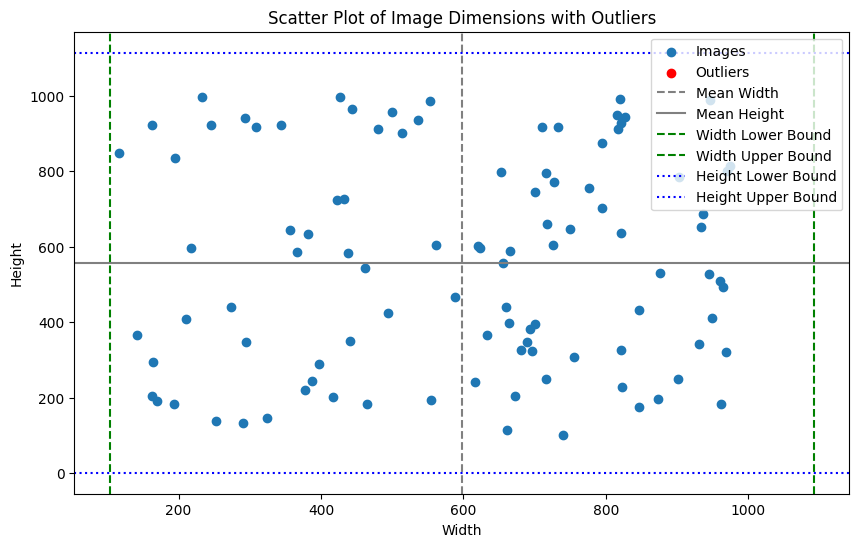

In [35]:
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import random

# Function to gather all image dimensions
def gather_image_dimensions(all_images):
    dimensions = []
    for folder_name, images in all_images.items():
        for img_path in images:
            with Image.open(img_path) as img:
                dimensions.append(img.size)
    return dimensions

# For demonstration, let's create some random dimensions
random.seed(0)  # for reproducibility
dimensions = [(random.randint(100, 1000), random.randint(100, 1000)) for _ in range(100)]

# Convert dimensions into a numpy array for analysis
dimensions = np.array(dimensions)
widths = dimensions[:, 0]
heights = dimensions[:, 1]

# Calculate mean and standard deviation for widths and heights
mean_width = np.mean(widths)
std_width = np.std(widths)
mean_height = np.mean(heights)
std_height = np.std(heights)

# Define thresholds for outliers
width_thresholds = (mean_width - 2 * std_width, mean_width + 2 * std_width)
height_thresholds = (mean_height - 2 * std_height, mean_height + 2 * std_height)

# Identify outliers
outlier_images = []
for size in dimensions:
    if size[0] < width_thresholds[0] or size[0] > width_thresholds[1] or size[1] < height_thresholds[0] or size[1] > height_thresholds[1]:
        outlier_images.append(size)

# Print total number of outliers
print(f"Total number of outlier images: {len(outlier_images)}")

# Explanation for why they are considered outliers
print("Outliers are considered as such because their dimensions fall outside of the typical range defined by the mean ± 2 standard deviations.")

# Plot
plt.figure(figsize=(10, 6))

# Scatter plot of widths and heights
plt.scatter(widths, heights, label='Images')

# Scatter plot of outliers
outlier_widths = [size[0] for size in outlier_images]
outlier_heights = [size[1] for size in outlier_images]
plt.scatter(outlier_widths, outlier_heights, color='red', label='Outliers')

# Plot mean lines
plt.axvline(mean_width, color='grey', linestyle='--', label='Mean Width')
plt.axhline(mean_height, color='grey', linestyle='-', label='Mean Height')

# Plot outlier threshold lines for width
plt.axvline(width_thresholds[0], color='green', linestyle='--', label='Width Lower Bound')
plt.axvline(width_thresholds[1], color='green', linestyle='--', label='Width Upper Bound')

# Plot outlier threshold lines for height
plt.axhline(height_thresholds[0], color='blue', linestyle=':', label='Height Lower Bound')
plt.axhline(height_thresholds[1], color='blue', linestyle=':', label='Height Upper Bound')

# Adding labels and legend
plt.xlabel('Width')
plt.ylabel('Height')
plt.title('Scatter Plot of Image Dimensions with Outliers')
plt.legend()

# Show the plot
plt.show()


### **Applying Models**

**Applying GANs to ExDark Dataset**

In [36]:
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Flatten, Dense
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import MeanAbsoluteError
import zipfile
import warnings
warnings.filterwarnings("ignore")



# Define function to extract zip file
def extract_zip(zip_path, extract_path):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_path)

# Load images with subcategories
def load_images_with_subcategories(dataset_path):
    images = []
    labels = []
    for category_name in os.listdir(dataset_path):
        category_path = os.path.join(dataset_path, category_name)
        if os.path.isdir(category_path):
            for subcategory_name in os.listdir(category_path):
                subcategory_path = os.path.join(category_path, subcategory_name)
                if os.path.isdir(subcategory_path):
                    for image_name in os.listdir(subcategory_path):
                        image_path = os.path.join(subcategory_path, image_name)
                        if os.path.isfile(image_path) and any(image_name.endswith(extension) for extension in ['.jpg', '.jpeg', '.png','.JPEG','.JPG','.PNG']):
                            image = cv2.imread(image_path)
                            if image is not None:
                                image = cv2.resize(image, (224, 224))
                                images.append(image / 255.0)
                                labels.append(subcategory_name)
                            else:
                                print(f"Error: Unable to read image '{image_path}'")
                        else:
                            print(f"Skipping: '{image_path}' is not a valid image file")
    return np.array(images), np.array(labels)

# Apply motion blur to images
def apply_motion_blur(images):
    motion_blurred_images = []
    for image in images:
        size = 15
        kernel_motion_blur = np.zeros((size, size))
        kernel_motion_blur[int((size-1)/2), :] = np.ones(size)
        kernel_motion_blur = kernel_motion_blur / size
        motion_blurred = cv2.filter2D(image, -1, kernel_motion_blur)
        motion_blurred_images.append(motion_blurred)
    return np.array(motion_blurred_images)

# Build generator model
def build_generator(input_shape):
    inputs = Input(shape=input_shape)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(inputs)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)
    outputs = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)
    generator = Model(inputs, outputs)
    return generator

# Build discriminator model
def build_discriminator(input_shape):
    inputs = Input(shape=input_shape)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(inputs)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Flatten()(x)
    outputs = Dense(1, activation='sigmoid')(x)
    discriminator = Model(inputs, outputs)
    return discriminator

# Build GAN (Generator + Discriminator)
def build_gan(generator, discriminator):
    discriminator.trainable = False
    gan_input = Input(shape=(224, 224, 3))
    generated_image = generator(gan_input)
    gan_output = discriminator(generated_image)
    gan = Model(gan_input, gan_output)
    return gan

# Apply PCA on images
def apply_pca(images, n_components=50):
    images_flattened = images.reshape(images.shape[0], -1)
    pca = PCA(n_components=n_components)
    pca.fit(images_flattened)
    images_pca = pca.transform(images_flattened)
    return images_pca, pca

# Define paths and parameters
exdark_zip_path = '/content/drive/My Drive/MyDataset/ExDark.zip'
extract_zip(exdark_zip_path, '/content/ExDark/ExDark')

dataset_path = '/content/ExDark/ExDark'
input_shape = (224, 224, 3)
latent_dim = 100
n_epochs = 20
batch_size = 32
n_components = 50

# Load images with subcategories
exdark_images, _ = load_images_with_subcategories(dataset_path)


# Take a subset of 300 images
subset_indices = np.random.choice(len(exdark_images), 50, replace=False)
subset_images = exdark_images[subset_indices]

# Apply motion blur to images
motion_blurred_images = apply_motion_blur(subset_images)

# Build generator and discriminator models
generator = build_generator(input_shape)
discriminator = build_discriminator(input_shape)

# Build GAN
gan = build_gan(generator, discriminator)

# Compile models
generator.compile(optimizer=Adam(), loss=MeanAbsoluteError())
discriminator.compile(optimizer=Adam(), loss='binary_crossentropy')
gan.compile(optimizer=Adam(), loss='binary_crossentropy')

Skipping: '/content/ExDark/ExDark/__MACOSX/ExDark/._People' is not a valid image file
Skipping: '/content/ExDark/ExDark/__MACOSX/ExDark/Table' is not a valid image file
Skipping: '/content/ExDark/ExDark/__MACOSX/ExDark/._Cup' is not a valid image file
Skipping: '/content/ExDark/ExDark/__MACOSX/ExDark/Dog' is not a valid image file
Skipping: '/content/ExDark/ExDark/__MACOSX/ExDark/._Boat' is not a valid image file
Skipping: '/content/ExDark/ExDark/__MACOSX/ExDark/Motorbike' is not a valid image file
Skipping: '/content/ExDark/ExDark/__MACOSX/ExDark/Cat' is not a valid image file
Skipping: '/content/ExDark/ExDark/__MACOSX/ExDark/._Dog' is not a valid image file
Skipping: '/content/ExDark/ExDark/__MACOSX/ExDark/Bottle' is not a valid image file
Skipping: '/content/ExDark/ExDark/__MACOSX/ExDark/._Cat' is not a valid image file
Skipping: '/content/ExDark/ExDark/__MACOSX/ExDark/._Bus' is not a valid image file
Skipping: '/content/ExDark/ExDark/__MACOSX/ExDark/._Motorbike' is not a valid imag

In [37]:
# Training loop
d_losses = []
g_losses = []

for epoch in range(n_epochs):
    print(f"Epoch: {epoch + 1}/{n_epochs}")
    epoch_d_losses = []
    epoch_g_losses = []
    for i in range(0, len(motion_blurred_images), batch_size):
        real_images = motion_blurred_images[i:i+batch_size]
        fake_labels = np.zeros((len(real_images), 1))
        real_labels = np.ones((len(real_images), 1))

        noise = np.random.randn(len(real_images), *input_shape)  # Adjust shape to match input shape of generator
        fake_images = generator.predict(noise)
        discriminator_loss_fake = discriminator.train_on_batch(fake_images, fake_labels)
        discriminator_loss_real = discriminator.train_on_batch(real_images, real_labels)
        discriminator_loss = 0.5 * np.add(discriminator_loss_fake, discriminator_loss_real)

        noise = np.random.randn(len(real_images), *input_shape)  # Adjust shape to match input shape of generator
        generator_loss = gan.train_on_batch(noise, real_labels)

        epoch_d_losses.append(discriminator_loss)
        epoch_g_losses.append(generator_loss)
        print(f"Batch {i // batch_size + 1}/{len(motion_blurred_images) // batch_size} -- D Loss: {discriminator_loss}, G Loss: {generator_loss}")

    # Average losses for the epoch
    average_d_loss = np.mean(epoch_d_losses)
    average_g_loss = np.mean(epoch_g_losses)
    d_losses.append(average_d_loss)
    g_losses.append(average_g_loss)


Epoch: 1/20
1/1 [==============================] - 1s 565ms/step
Batch 1/1 -- D Loss: 0.6635335087776184, G Loss: 0.8311159610748291
1/1 [==============================] - 0s 365ms/step


Batch 2/1 -- D Loss: 0.6661902070045471, G Loss: 0.7987258434295654
Epoch: 2/20
1/1 [==============================] - 0s 37ms/step
Batch 1/1 -- D Loss: 0.6889800131320953, G Loss: 0.7696307897567749
1/1 [==============================] - 0s 24ms/step
Batch 2/1 -- D Loss: 0.6884642243385315, G Loss: 0.7476723194122314
Epoch: 3/20
1/1 [==============================] - 0s 36ms/step
Batch 1/1 -- D Loss: 0.707285612821579, G Loss: 0.7293621897697449
1/1 [==============================] - 0s 23ms/step
Batch 2/1 -- D Loss: 0.7024196684360504, G Loss: 0.7168212532997131
Epoch: 4/20
1/1 [==============================] - 0s 31ms/step
Batch 1/1 -- D Loss: 0.7172476947307587, G Loss: 0.7081300020217896
1/1 [==============================] - 0s 23ms/step
Batch 2/1 -- D Loss: 0.7092445492744446, G Loss: 0.7020208239555359
Epoch: 5/20
1/1 [==============================] - 0s 33ms/step
Batch 1/1 -- D Loss: 0.7217161059379578, G Loss: 0.6986342668533325
1/1 [==============================] - 0s 22m

**Training Loss and Validation**

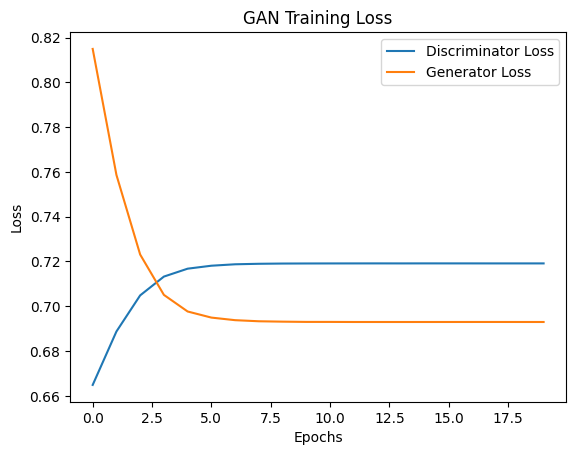

In [38]:
# Plot loss graph
plt.plot(d_losses, label='Discriminator Loss')
plt.plot(g_losses, label='Generator Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('GAN Training Loss')
plt.legend()
plt.show()

# Resize motion blurred images to match original images
motion_blurred_images_resized = []
for image in motion_blurred_images:
    resized_image = cv2.resize(image, (224, 224))
    motion_blurred_images_resized.append(resized_image)

**Displaying Output**

Image 2 - GAN PSNR: 13.54, SSIM: 0.5147
Image 3 - GAN PSNR: 13.28, SSIM: 0.2604
Image 4 - GAN PSNR: 14.29, SSIM: 0.3922


Image 5 - GAN PSNR: 14.80, SSIM: 0.4735
Image 6 - GAN PSNR: 15.21, SSIM: 0.2855


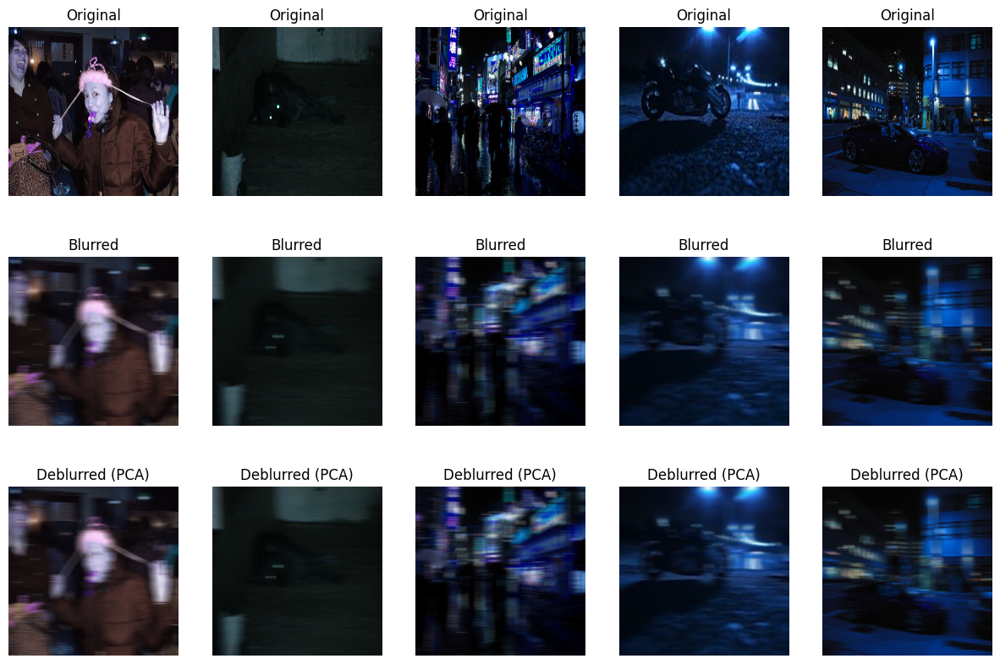

In [39]:
import warnings
warnings.filterwarnings("ignore")

# Apply PCA on motion blurred images
motion_blurred_images_pca, pca = apply_pca(motion_blurred_images, n_components=n_components)

# Visualize the images
plt.figure(figsize=(15, 10))

# Loop over 5 sample indices
for i, sample_index in enumerate(range(5), 1):
    # Original image
    plt.subplot(3, 5, i)
    plt.imshow(subset_images[sample_index])
    plt.title('Original')
    plt.axis('off')

    # Blurred image
    plt.subplot(3, 5, i + 5)
    plt.imshow(motion_blurred_images[sample_index])
    plt.title('Blurred')
    plt.axis('off')

    # Deblurred image using the trained generator
    sample_blurred_image_pca = pca.transform(motion_blurred_images[sample_index].reshape(1, -1))
    sample_deblurred_image_pca = pca.inverse_transform(sample_blurred_image_pca).reshape(224, 224, 3)
    sample_deblurred_image_pca = np.clip(sample_deblurred_image_pca, 0, 1)

    plt.subplot(3, 5, i + 10)
    plt.imshow(sample_deblurred_image_pca)
    plt.title('Deblurred (PCA)')
    plt.axis('off')

    # Calculate PSNR and SSIM for GAN
    psnr_value = psnr(subset_images[i], sample_deblurred_image_pca)
    ssim_value = ssim(subset_images[i], sample_deblurred_image_pca, multichannel=True)
    print(f"Image {i+1} - GAN PSNR: {psnr_value:.2f}, SSIM: {ssim_value:.4f}")

plt.show()

While applying algorithms to low light images, Only GAN combined with PCA gave us results, all the other algorithms failed generate deblurred images for the ExDark Dataset.

**Applying CNN to ExDark Dataset**

In [40]:
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import MeanAbsoluteError
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping
import zipfile
import warnings
warnings.filterwarnings("ignore")

def apply_data_augmentation(images):
    datagen = ImageDataGenerator(rotation_range=10, horizontal_flip=True)
    augmented_images = []
    for image in images:
        augmented_image = datagen.random_transform(image)
        augmented_images.append(augmented_image)
    return np.array(augmented_images)

# Define input shape
input_shape = (224, 224, 3)

# Define CNN model
inputs = Input(shape=input_shape)
x = Conv2D(32, (3, 3), activation='relu', padding='same')(inputs)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
encoded = MaxPooling2D((2, 2), padding='same')(x)

# at this point the representation is (28, 28, 128)

x = Conv2D(128, (3, 3), activation='relu', padding='same')(encoded)
x = UpSampling2D((2, 2))(x)
x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
decoded = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)

cnn_model = Model(inputs, decoded)

# Compile the model with Mean Absolute Error loss and reduce learning rate
optimizer = Adam(lr=0.001)
cnn_model.compile(optimizer=optimizer, loss=MeanAbsoluteError())

# Train the CNN model with data augmentation
history = cnn_model.fit(apply_data_augmentation(motion_blurred_images), motion_blurred_images,
                        epochs=20, batch_size=32, validation_split=0.2)

# Deblur the images
deblurred_images = cnn_model.predict(motion_blurred_images)

Epoch 1/20
2/2 [==============================] - 5s 1s/step - loss: 0.3701 - val_loss: 0.3786
Epoch 2/20
2/2 [==============================] - 0s 46ms/step - loss: 0.3368 - val_loss: 0.2793
Epoch 3/20
2/2 [==============================] - 0s 42ms/step - loss: 0.2508 - val_loss: 0.1459
Epoch 4/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1801 - val_loss: 0.1086
Epoch 5/20
2/2 [==============================] - 0s 44ms/step - loss: 0.1598 - val_loss: 0.1069
Epoch 6/20
2/2 [==============================] - 0s 46ms/step - loss: 0.1584 - val_loss: 0.1066
Epoch 7/20
2/2 [==============================] - 0s 45ms/step - loss: 0.1582 - val_loss: 0.1066
Epoch 8/20
2/2 [==============================] - 0s 47ms/step - loss: 0.1582 - val_loss: 0.1066
Epoch 9/20
2/2 [==============================] - 0s 43ms/step - loss: 0.1582 - val_loss: 0.1066
Epoch 10/20
2/2 [==============================] - 0s 47ms/step - loss: 0.1582 - val_loss: 0.1066
Epoch 11/20
2/2 [==============

**Printing Output**

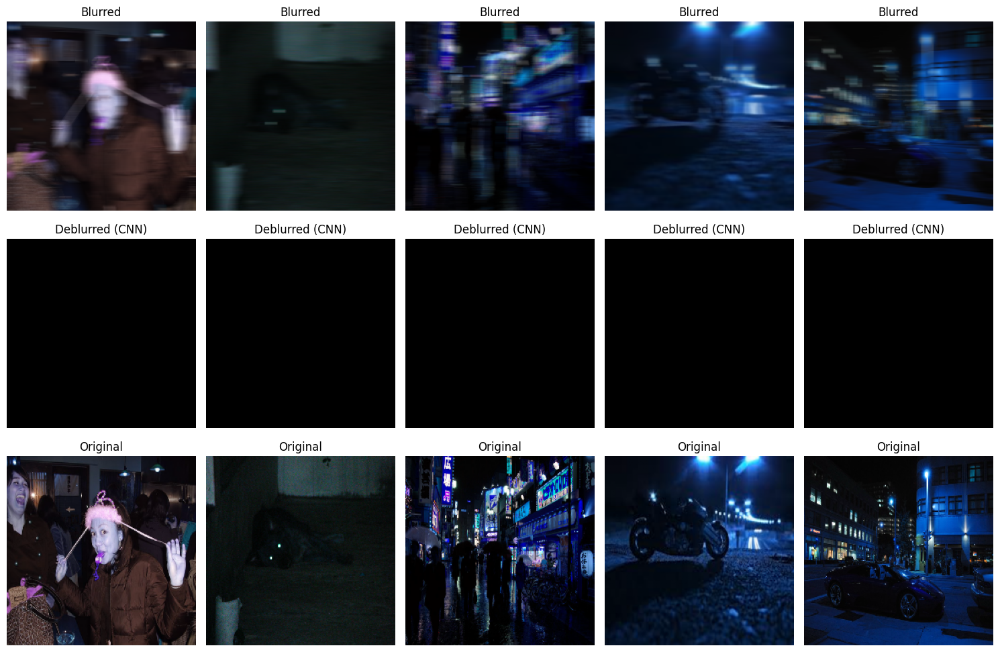

In [41]:
plt.figure(figsize=(15, 10))

num_images = 5  # Number of images to display
for i in range(num_images):
    plt.subplot(3, num_images, 2 * num_images + i + 1)
    plt.imshow(subset_images[i])
    plt.title('Original')
    plt.axis('off')

for i in range(num_images):
    plt.subplot(3, num_images, i + 1)
    plt.imshow(motion_blurred_images[i])
    plt.title('Blurred')
    plt.axis('off')

for i in range(num_images):
    plt.subplot(3, num_images, num_images + i + 1)
    plt.imshow(deblurred_images[i])
    plt.title('Deblurred (CNN)')
    plt.axis('off')

plt.tight_layout()
plt.show()

CNN was not able to generate any deblurred images even after increasing the epochs to 20 and with a batch size of 20

**Training Loss**

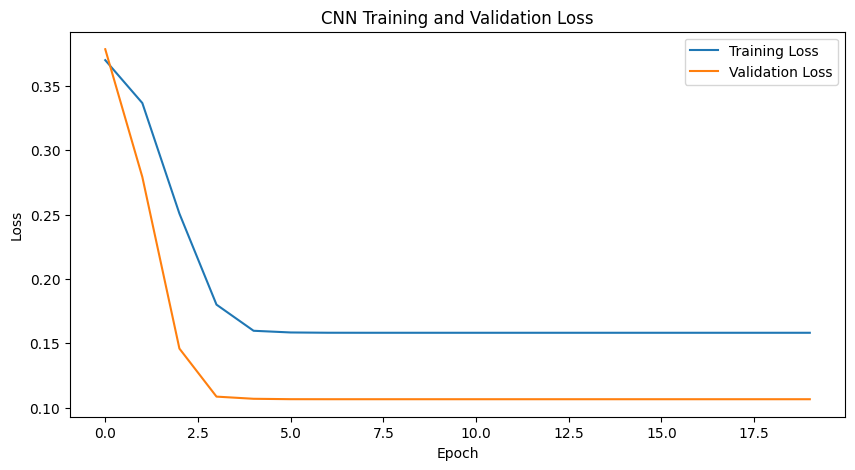

In [42]:
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim

# Plot loss
plt.figure(figsize=(10, 5))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('CNN Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Calculate PSNR and SSIM for each image
psnr_values = []
ssim_values = []
for i in range(len(subset_images)):
    original_image = subset_images[i]
    blurred_image = motion_blurred_images[i]
    deblurred_image = deblurred_images[i]

    psnr_val = psnr(original_image, deblurred_image)
    ssim_val = ssim(original_image, deblurred_image, multichannel=True)

    psnr_values.append(psnr_val)
    ssim_values.append(ssim_val)

**Applying AutoEncoder to ExDark Dataset**

In [43]:
from tensorflow.keras.optimizers import Adam

# Define autoencoder model
def autoencoder(input_shape=(224, 224, 3)):
    inputs = Input(shape=input_shape)

    # Encoder
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(inputs)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, 3, activation='relu', padding='same')(pool1)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(256, 3, activation='relu', padding='same')(pool2)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = Conv2D(512, 3, activation='relu', padding='same')(pool3)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)

    # Decoder
    conv5 = Conv2D(512, 3, activation='relu', padding='same')(pool4)
    up1 = UpSampling2D(size=(2, 2))(conv5)

    conv6 = Conv2D(256, 3, activation='relu', padding='same')(up1)
    up2 = UpSampling2D(size=(2, 2))(conv6)

    conv7 = Conv2D(128, 3, activation='relu', padding='same')(up2)
    up3 = UpSampling2D(size=(2, 2))(conv7)

    conv8 = Conv2D(64, 3, activation='relu', padding='same')(up3)
    up4 = UpSampling2D(size=(2, 2))(conv8)

    outputs = Conv2D(3, 3, activation='sigmoid', padding='same')(up4)

    model = Model(inputs=inputs, outputs=outputs)
    return model

# Define autoencoder model
autoencoder_model = autoencoder()

# Define optimizer
optimizer = Adam(learning_rate=0.0001)

# Compile the model with Mean Absolute Error loss
autoencoder_model.compile(optimizer=optimizer, loss=MeanAbsoluteError())

# Train the autoencoder model with data augmentation
history_autoencoder = autoencoder_model.fit(apply_data_augmentation(motion_blurred_images), motion_blurred_images,
                                            epochs=20, batch_size=32, validation_split=0.2)

Epoch 1/20
2/2 [==============================] - 8s 2s/step - loss: 0.3703 - val_loss: 0.3931
Epoch 2/20
2/2 [==============================] - 0s 63ms/step - loss: 0.3587 - val_loss: 0.3728
Epoch 3/20
2/2 [==============================] - 0s 66ms/step - loss: 0.3308 - val_loss: 0.3311
Epoch 4/20
2/2 [==============================] - 0s 64ms/step - loss: 0.2895 - val_loss: 0.2634
Epoch 5/20
2/2 [==============================] - 0s 64ms/step - loss: 0.2420 - val_loss: 0.1906
Epoch 6/20
2/2 [==============================] - 0s 69ms/step - loss: 0.2023 - val_loss: 0.1468
Epoch 7/20
2/2 [==============================] - 0s 64ms/step - loss: 0.1798 - val_loss: 0.1229
Epoch 8/20
2/2 [==============================] - 0s 68ms/step - loss: 0.1695 - val_loss: 0.1118
Epoch 9/20
2/2 [==============================] - 0s 65ms/step - loss: 0.1635 - val_loss: 0.1085
Epoch 10/20
2/2 [==============================] - 0s 64ms/step - loss: 0.1604 - val_loss: 0.1074
Epoch 11/20
2/2 [==============

**Training and Validation Loss**

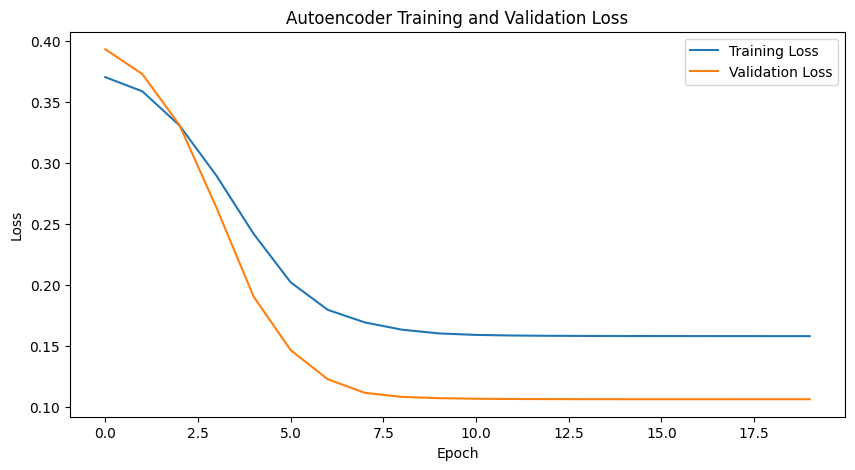

In [44]:
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim

# Plot training and validation loss for autoencoder
plt.figure(figsize=(10, 5))
plt.plot(history_autoencoder.history['loss'], label='Training Loss')
plt.plot(history_autoencoder.history['val_loss'], label='Validation Loss')
plt.title('Autoencoder Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

**Output**

1/1 [==============================] - 0s 403ms/step


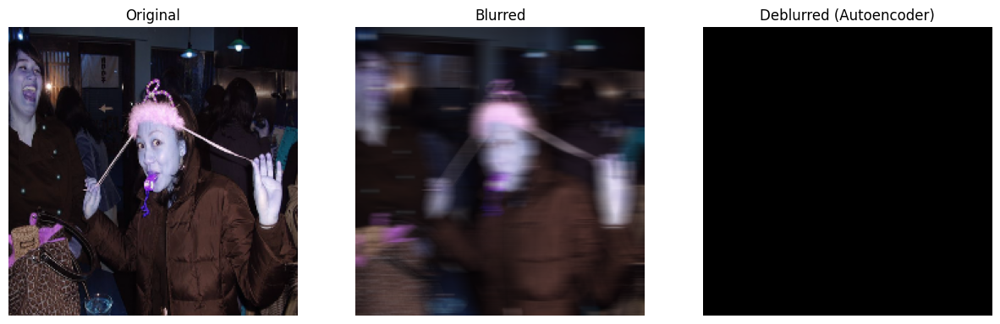

Image 1 - Autoencoder PSNR: 11.24, SSIM: 0.0467
1/1 [==============================] - 0s 18ms/step


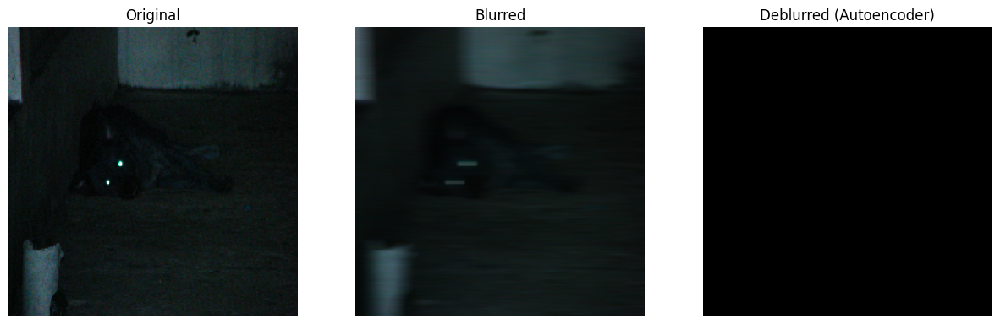

Image 2 - Autoencoder PSNR: 18.57, SSIM: 0.0874
1/1 [==============================] - 0s 18ms/step


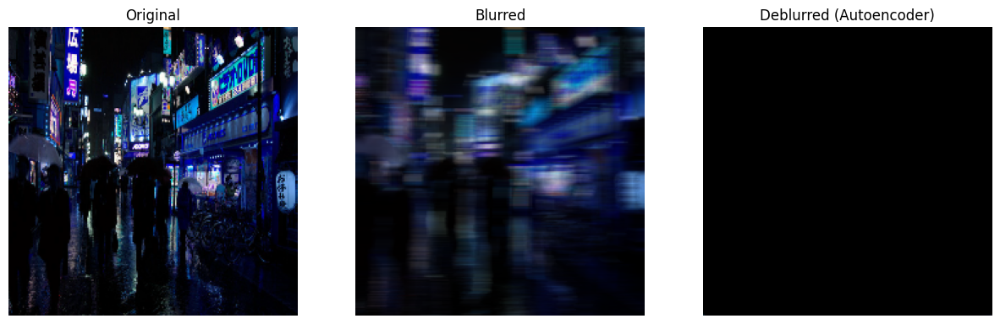

Image 3 - Autoencoder PSNR: 12.24, SSIM: 0.2552
1/1 [==============================] - 0s 17ms/step


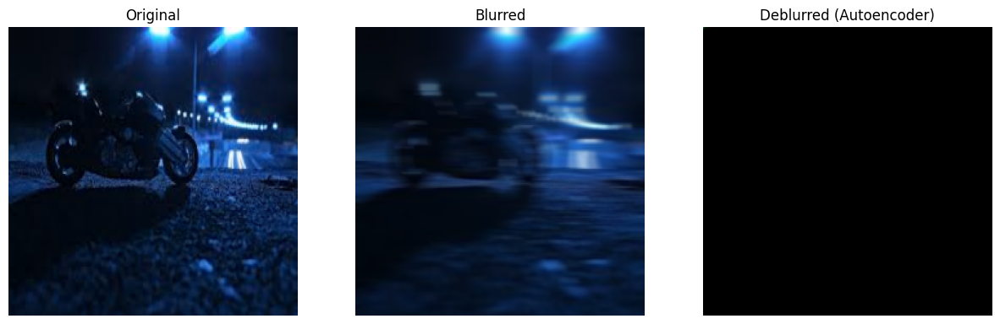

Image 4 - Autoencoder PSNR: 13.27, SSIM: 0.1449
1/1 [==============================] - 0s 18ms/step


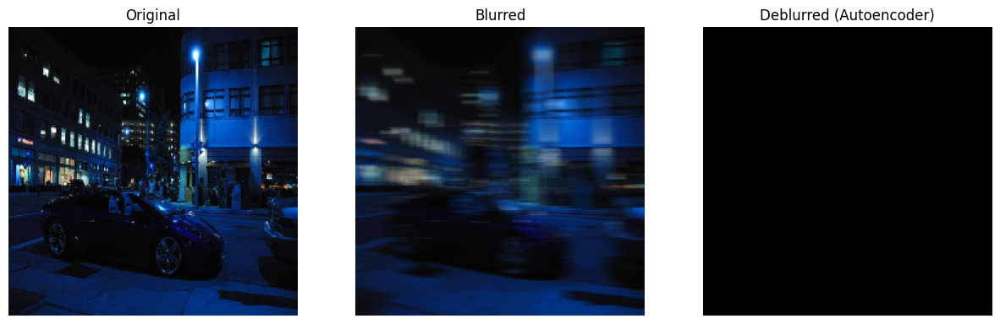

Image 5 - Autoencoder PSNR: 13.68, SSIM: 0.1292


In [45]:
# Visualize original, blurred, and deblurred images for autoencoder
for i in range(5):
    # Original image
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(subset_images[i])
    plt.title('Original')
    plt.axis('off')

    # Blurred image
    plt.subplot(1, 3, 2)
    plt.imshow(motion_blurred_images[i])
    plt.title('Blurred')
    plt.axis('off')

    # Deblurred image (autoencoder)
    plt.subplot(1, 3, 3)
    deblurred_image_autoencoder = autoencoder_model.predict(np.expand_dims(motion_blurred_images[i], axis=0))[0]
    plt.imshow(deblurred_image_autoencoder)
    plt.title('Deblurred (Autoencoder)')
    plt.axis('off')

    plt.show()

    # Calculate PSNR and SSIM for autoencoder
    psnr_value = psnr(subset_images[i], deblurred_image_autoencoder)
    ssim_value = ssim(subset_images[i], deblurred_image_autoencoder, multichannel=True)
    print(f"Image {i+1} - Autoencoder PSNR: {psnr_value:.2f}, SSIM: {ssim_value:.4f}")

Just like CNN, AutoEncoder failed to generate the outputs which is also evident from the low SSIM and PSNR values

**Applying U-Net Model to ExDark Dataset**

In [46]:
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate
from tensorflow.keras.models import Model

# Define U-Net model
def unet(input_shape=(224, 224, 3)):
    inputs = Input(shape=input_shape)

    # Encoder
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, 3, activation='relu', padding='same')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(256, 3, activation='relu', padding='same')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = Conv2D(512, 3, activation='relu', padding='same')(pool3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same')(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)
    conv5 = Conv2D(1024, 3, activation='relu', padding='same')(pool4)
    conv5 = Conv2D(1024, 3, activation='relu', padding='same')(conv5)

    # Decoder
    up6 = concatenate([UpSampling2D(size=(2, 2))(conv5), conv4], axis=-1)
    conv6 = Conv2D(512, 3, activation='relu', padding='same')(up6)
    conv6 = Conv2D(512, 3, activation='relu', padding='same')(conv6)

    up7 = concatenate([UpSampling2D(size=(2, 2))(conv6), conv3], axis=-1)
    conv7 = Conv2D(256, 3, activation='relu', padding='same')(up7)
    conv7 = Conv2D(256, 3, activation='relu', padding='same')(conv7)

    up8 = concatenate([UpSampling2D(size=(2, 2))(conv7), conv2], axis=-1)
    conv8 = Conv2D(128, 3, activation='relu', padding='same')(up8)
    conv8 = Conv2D(128, 3, activation='relu', padding='same')(conv8)

    up9 = concatenate([UpSampling2D(size=(2, 2))(conv8), conv1], axis=-1)
    conv9 = Conv2D(64, 3, activation='relu', padding='same')(up9)
    conv9 = Conv2D(64, 3, activation='relu', padding='same')(conv9)

    outputs = Conv2D(3, 1, activation='sigmoid')(conv9)

    model = Model(inputs=inputs, outputs=outputs)
    return model

# Define U-Net model
unet_model = unet()

# Compile the model with Mean Absolute Error loss and reduce learning rate
optimizer = Adam(learning_rate=0.0001)
unet_model.compile(optimizer=optimizer, loss=MeanAbsoluteError())

# Train the U-Net model with data augmentation
history_unet = unet_model.fit(apply_data_augmentation(motion_blurred_images), motion_blurred_images,
                              epochs=10, batch_size=32, validation_split=0.2)


Epoch 1/10
2/2 [==============================] - 27s 7s/step - loss: 0.3717 - val_loss: 0.3999
Epoch 2/10
2/2 [==============================] - 1s 181ms/step - loss: 0.3693 - val_loss: 0.3975
Epoch 3/10
2/2 [==============================] - 1s 183ms/step - loss: 0.3666 - val_loss: 0.3933
Epoch 4/10
2/2 [==============================] - 1s 180ms/step - loss: 0.3614 - val_loss: 0.3796
Epoch 5/10
2/2 [==============================] - 1s 181ms/step - loss: 0.3445 - val_loss: 0.3125
Epoch 6/10
2/2 [==============================] - 1s 182ms/step - loss: 0.2740 - val_loss: 0.1487
Epoch 7/10
2/2 [==============================] - 1s 181ms/step - loss: 0.1754 - val_loss: 0.1087
Epoch 8/10
2/2 [==============================] - 1s 180ms/step - loss: 0.1595 - val_loss: 0.1067
Epoch 9/10
2/2 [==============================] - 1s 180ms/step - loss: 0.1583 - val_loss: 0.1066
Epoch 10/10
2/2 [==============================] - 1s 178ms/step - loss: 0.1582 - val_loss: 0.1066


**Training and Validation Loss**

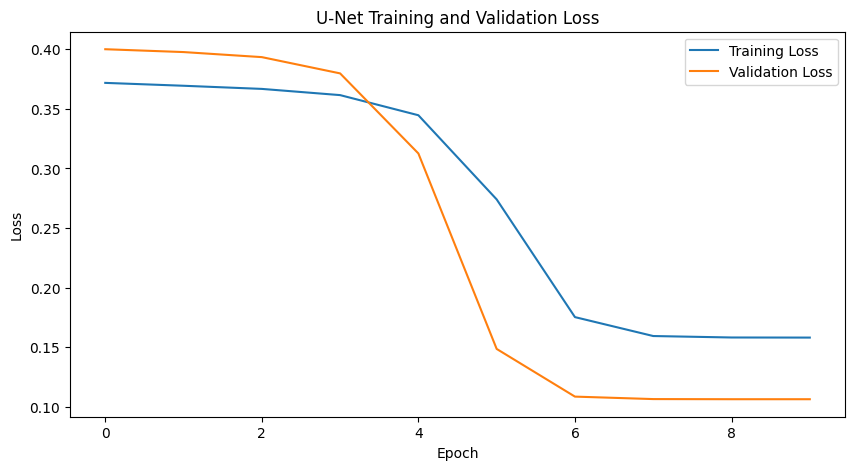

In [47]:
# Plot training and validation loss for U-Net
plt.figure(figsize=(10, 5))
plt.plot(history_unet.history['loss'], label='Training Loss')
plt.plot(history_unet.history['val_loss'], label='Validation Loss')
plt.title('U-Net Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

**Outputs**

1/1 [==============================] - 1s 779ms/step


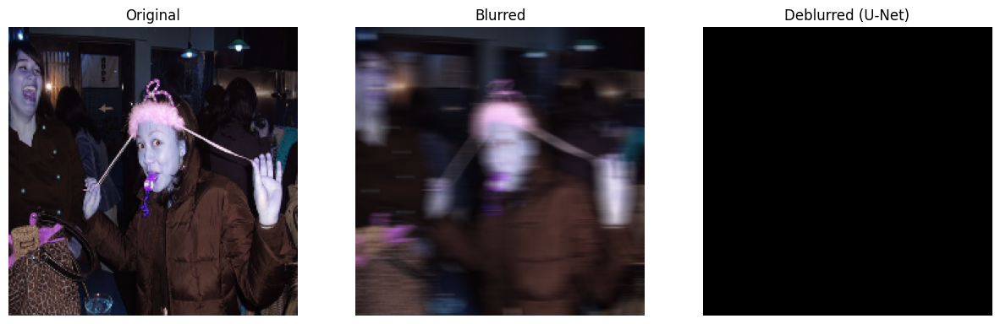

Image 1 - U-Net PSNR: 11.37, SSIM: 0.4104
1/1 [==============================] - 0s 20ms/step


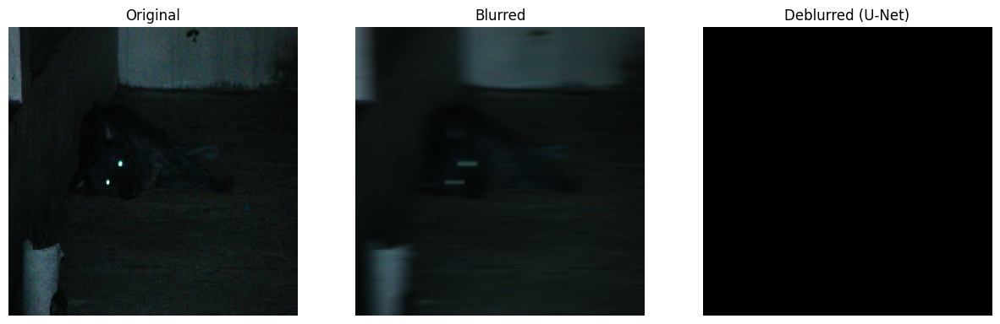

Image 2 - U-Net PSNR: 26.62, SSIM: 0.5341
1/1 [==============================] - 0s 20ms/step


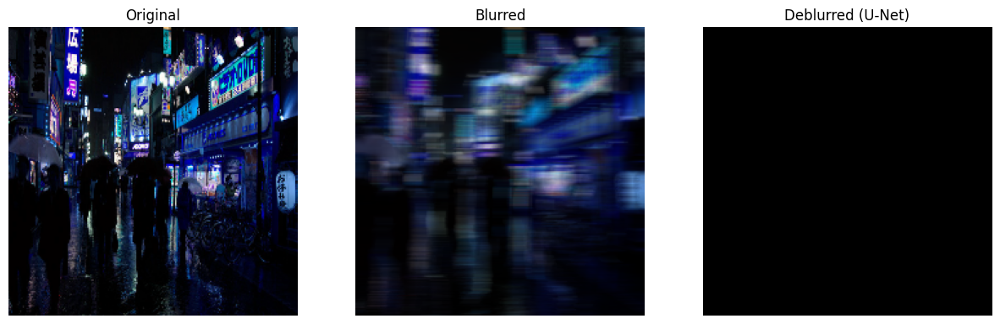

Image 3 - U-Net PSNR: 11.40, SSIM: 0.1280
1/1 [==============================] - 0s 20ms/step


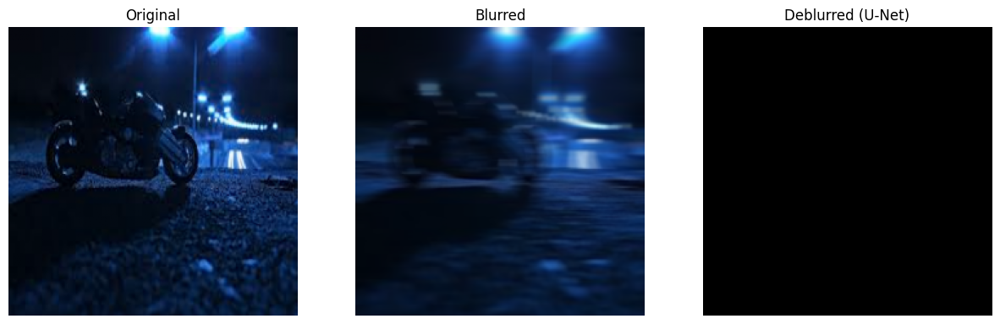

Image 4 - U-Net PSNR: 16.11, SSIM: 0.4942
1/1 [==============================] - 0s 20ms/step


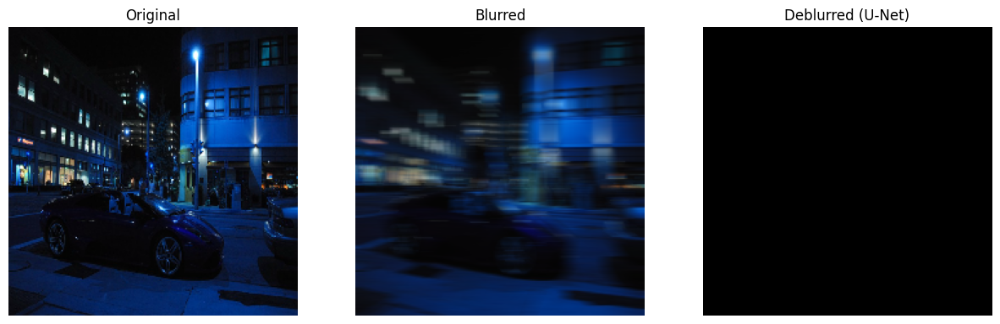

Image 5 - U-Net PSNR: 10.58, SSIM: 0.0250


In [48]:
# Visualize original, blurred, and deblurred images for U-Net
for i in range(5):
    # Original image
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(subset_images[i])
    plt.title('Original')
    plt.axis('off')

    # Blurred image
    plt.subplot(1, 3, 2)
    plt.imshow(motion_blurred_images[i])
    plt.title('Blurred')
    plt.axis('off')

    # Deblurred image (U-Net)
    plt.subplot(1, 3, 3)
    deblurred_image_unet = unet_model.predict(np.expand_dims(motion_blurred_images[i], axis=0))[0]
    plt.imshow(deblurred_image_unet)
    plt.title('Deblurred (U-Net)')
    plt.axis('off')

    plt.show()

    # Calculate PSNR and SSIM for U-Net
    psnr_value = psnr(exdark_images[i], deblurred_image_unet)
    ssim_value = ssim(exdark_images[i], deblurred_image_unet, multichannel=True)
    print(f"Image {i+1} - U-Net PSNR: {psnr_value:.2f}, SSIM: {ssim_value:.4f}")

Just like CNN and AutoEncoder, U-Net failed to generate the outputs which is also evident from the low SSIM and PSNR values

## Merging HDR+ & ExDark Dataset

In [49]:
import os
import random

# Function to randomly sample files from a directory
def sample_images(directory, sample_size):
    all_files = []
    # Walk through all files in the directory and subdirectories
    for root, dirs, files in os.walk(directory):
        all_files += [os.path.join(root, file) for file in files if file.endswith(('.png', '.jpg', '.jpeg'))]
    # Randomly sample the specified number of images
    if len(all_files) < sample_size:
        print(f"Warning: Not enough images to sample {sample_size}. Sampling {len(all_files)} instead.")
        return all_files
    return random.sample(all_files, sample_size)

# Directories containing the HDR+ and ExDark datasets
hdr_plus_dir = '/content/dataset'
exdark_dir = '/content/drive/My Drive/extracted_folders/ExDark/'

# Sample images
hdr_plus_samples = sample_images(hdr_plus_dir, 200)
exdark_samples = sample_images(exdark_dir, 300)

# Combine the samples into a single dataset
merged_dataset = hdr_plus_samples + exdark_samples

# Optionally, save the combined list of image paths if needed
combined_samples_path = '/content/combined_samples.txt'
with open(combined_samples_path, 'w') as file:
    for path in merged_dataset:
        file.write(path + '\n')

print(f"Combined dataset created with {len(merged_dataset)} images. Paths saved to {combined_samples_path}.")


Combined dataset created with 500 images. Paths saved to /content/combined_samples.txt.


**Sample of 16 images from the new combined dataset**

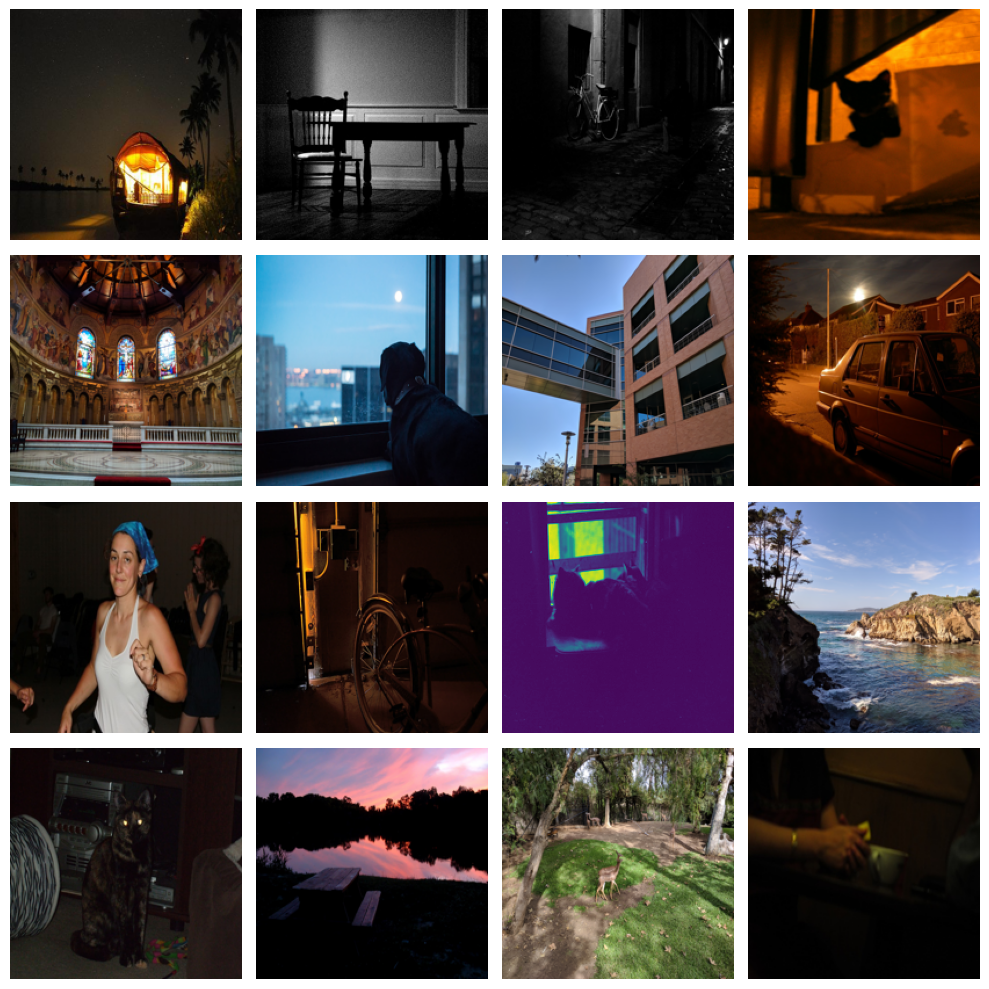

In [50]:
import matplotlib.pyplot as plt
from PIL import Image
import random

# Load the paths of the combined samples
combined_samples_path = '/content/combined_samples.txt'
with open(combined_samples_path, 'r') as file:
    merged_dataset = [line.strip() for line in file]

# Randomly select 16 images to display
selected_images = random.sample(merged_dataset, 16)

# Set up the figure for a 4x4 grid
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(10, 10))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Display each image in the grid
for ax, img_path in zip(axes, selected_images):
    img = Image.open(img_path)
    img = img.resize((200, 200))  # Resize the image to 200x200
    ax.imshow(img)
    ax.axis('off')  # Turn off axis

plt.tight_layout()
plt.show()


**Applying CNN to the Merged Dataset**

Epoch 1/20
8/8 [==============================] - 3s 119ms/step - loss: 0.1258 - accuracy: 0.6041 - val_loss: 0.1269 - val_accuracy: 0.6625
Epoch 2/20
8/8 [==============================] - 0s 58ms/step - loss: 0.0933 - accuracy: 0.6491 - val_loss: 0.0547 - val_accuracy: 0.5315
Epoch 3/20
8/8 [==============================] - 0s 57ms/step - loss: 0.0362 - accuracy: 0.5106 - val_loss: 0.0176 - val_accuracy: 0.5253
Epoch 4/20
8/8 [==============================] - 0s 55ms/step - loss: 0.0263 - accuracy: 0.5165 - val_loss: 0.0176 - val_accuracy: 0.5133
Epoch 5/20
8/8 [==============================] - 0s 55ms/step - loss: 0.0218 - accuracy: 0.5434 - val_loss: 0.0117 - val_accuracy: 0.5081
Epoch 6/20
8/8 [==============================] - 0s 54ms/step - loss: 0.0166 - accuracy: 0.5203 - val_loss: 0.0089 - val_accuracy: 0.5115
Epoch 7/20
8/8 [==============================] - 0s 55ms/step - loss: 0.0136 - accuracy: 0.6066 - val_loss: 0.0075 - val_accuracy: 0.6117
Epoch 8/20
8/8 [==========

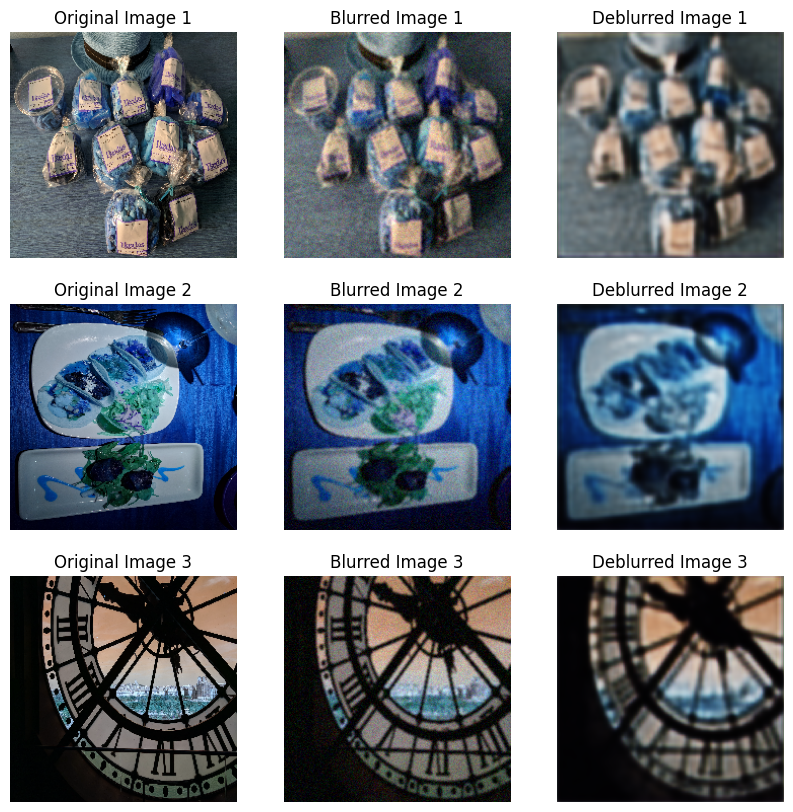

In [51]:
import cv2
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D
from tensorflow.keras.models import Model

# Define function to build CNN model
def build_cnn_model(input_shape):
    inputs = Input(shape=input_shape)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(inputs)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    encoded = MaxPooling2D((2, 2), padding='same')(x)

    x = Conv2D(32, (3, 3), activation='relu', padding='same')(encoded)
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)
    decoded = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)

    cnn_model = Model(inputs, decoded)
    cnn_model.compile(optimizer='adam', loss='mse', metrics=['accuracy'])
    return cnn_model

# Define function to preprocess images for training
def preprocess_images(image_paths, target_size):
    images = []
    for img_path in image_paths:
        img = cv2.imread(img_path)
        img = cv2.resize(img, target_size)
        img = img.astype('float32') / 255.0  # Normalize to [0, 1]
        images.append(img)
    return np.array(images)

# Define function to generate blurred images
def generate_blurred_images(images):
    blurred_images = []
    for image in images:
        blurred = cv2.GaussianBlur(image, (5, 5), 0)
        blurred = np.clip(blurred + np.random.normal(scale=0.05, size=blurred.shape), 0, 1)  # Add noise
        blurred_images.append(blurred)
    return np.array(blurred_images)

# Load and preprocess original images
original_images = preprocess_images(merged_dataset, (224, 224))

# Generate blurred images
blurred_images = generate_blurred_images(original_images)

# Build and train the CNN model
input_shape = (224, 224, 3)
cnn_model = build_cnn_model(input_shape)
cnn_history = cnn_model.fit(blurred_images, original_images, epochs=20, batch_size=50, validation_split=0.2)

# Deblur the sample blurred image using CNN
sample_deblurred_cnn = cnn_model.predict(blurred_images[:3])

# Show original, blurred, and deblurred images
titles = ['Original', 'Blurred', 'Deblurred']
fig, axs = plt.subplots(3, 3, figsize=(10, 10))
for i in range(3):
    for j, title in enumerate(titles):
        if title == 'Original':
            axs[i, j].imshow(original_images[i])
        elif title == 'Blurred':
            axs[i, j].imshow(blurred_images[i])
        else:
            axs[i, j].imshow(sample_deblurred_cnn[i])
        axs[i, j].set_title(f"{titles[j]} Image {i+1}")
        axs[i, j].axis('off')
plt.show()


**Evaluation**

In [52]:
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr

# Function to calculate SSIM and PSNR for each pair of images
def calculate_metrics(originals, blurries, deblurries):
    ssim_blurred = []
    ssim_deblurred = []
    psnr_blurred = []
    psnr_deblurred = []

    for original, blurred, deblurred in zip(originals, blurries, deblurries):
        original = (original * 255).astype(np.uint8)
        blurred = (blurred * 255).astype(np.uint8)
        deblurred = (deblurred * 255).astype(np.uint8)

        # Calculate metrics for blurred images
        ssim_blurred.append(ssim(original, blurred, multichannel=True))
        psnr_blurred.append(psnr(original, blurred))

        # Calculate metrics for deblurred images
        ssim_deblurred.append(ssim(original, deblurred, multichannel=True))
        psnr_deblurred.append(psnr(original, deblurred))

    return ssim_blurred, ssim_deblurred, psnr_blurred, psnr_deblurred

# Apply the function
ssim_blur, ssim_deblur, psnr_blur, psnr_deblur = calculate_metrics(original_images[:3], blurred_images[:3], sample_deblurred_cnn)

# Print the results
for i in range(3):
    print(f"Image {i+1} - SSIM Blurred: {ssim_blur[i]}, SSIM Deblurred: {ssim_deblur[i]}")
    print(f"Image {i+1} - PSNR Blurred: {psnr_blur[i]}, PSNR Deblurred: {psnr_deblur[i]}")


Image 1 - SSIM Blurred: 0.5073969814548449, SSIM Deblurred: 0.4605872415354195
Image 1 - PSNR Blurred: 20.87428696816503, PSNR Deblurred: 19.788386615129486
Image 2 - SSIM Blurred: 0.516118793431435, SSIM Deblurred: 0.488096325982907
Image 2 - PSNR Blurred: 22.112171518696222, PSNR Deblurred: 20.431870729288054
Image 3 - SSIM Blurred: 0.5873146361838318, SSIM Deblurred: 0.5523909340106102
Image 3 - PSNR Blurred: 20.409433716778835, PSNR Deblurred: 17.493861651311185


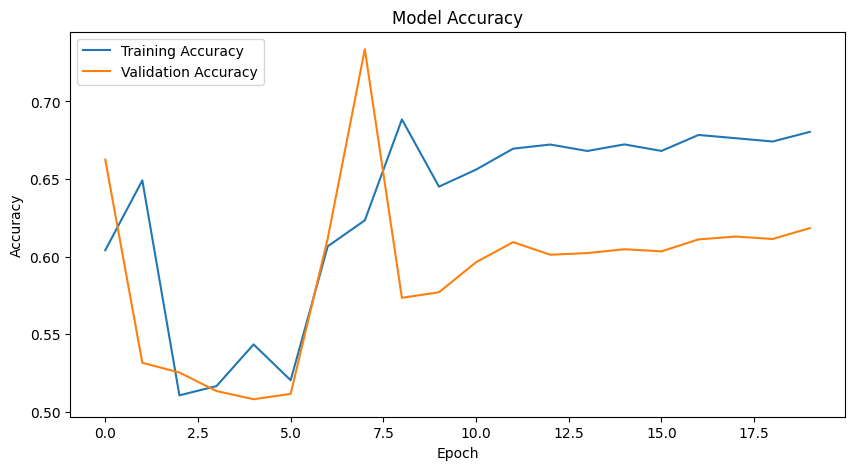

In [53]:
import matplotlib.pyplot as plt

# Plotting the training and validation accuracy
plt.figure(figsize=(10, 5))
plt.plot(cnn_history.history['accuracy'], label='Training Accuracy')
plt.plot(cnn_history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()


### **Applying Advanced and Complex CNN**
- #### **We got the best results by this model after combining the 2 subsets from both the datasets.**

In [54]:
# Start by importing the necessary libraries
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.utils import save_image
import os
import cv2
from tqdm import tqdm
from sklearn.model_selection import train_test_split

# Define the CNN model architecture as shown previously
class CNN(nn.Module):
    def __init__(self):
        super(CNN, self).__init__()
        self.conv1 = nn.Conv2d(3, 128, kernel_size=5, padding=1)
        self.conv2 = nn.Conv2d(128, 64, kernel_size=3, padding=1)
        self.conv3 = nn.Conv2d(64, 3, kernel_size=1, padding=1)

    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        return x

# Load the dataset paths from the combined samples
dataset_paths = []
with open('/content/combined_samples.txt', 'r') as file:
    dataset_paths = file.readlines()
    dataset_paths = [path.strip() for path in dataset_paths]

# Randomly split the dataset paths into training and validation sets
train_paths, val_paths = train_test_split(dataset_paths, test_size=0.25, random_state=42)

# Define the transformations for the images
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

# Define a custom dataset class
class ImageDataset(Dataset):
    def __init__(self, image_paths, transforms=None):
        self.image_paths = image_paths
        self.transforms = transforms

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, index):
        img_path = self.image_paths[index]
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert from BGR to RGB

        if self.transforms:
            image = self.transforms(image)

        return image, image  # Return the image as both input and target for simplicity

# Create dataset and dataloader instances
train_dataset = ImageDataset(train_paths, transform)
val_dataset = ImageDataset(val_paths, transform)
train_loader = DataLoader(train_dataset, batch_size=2, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=2, shuffle=False)

# Initialize the model, criterion, and optimizer
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = CNN().to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Define the training and validation functions
def train(model, dataloader):
    model.train()
    running_loss = 0.0
    for inputs, targets in tqdm(dataloader):
        inputs, targets = inputs.to(device), targets.to(device)
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, targets)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    return running_loss / len(dataloader)

def validate(model, dataloader):
    model.eval()
    running_loss = 0.0
    with torch.no_grad():
        for inputs, targets in tqdm(dataloader):
            inputs, targets = inputs.to(device), targets.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            running_loss += loss.item()
    return running_loss / len(dataloader)

# Training loop
epochs = 10
for epoch in range(epochs):
    train_loss = train(model, train_loader)
    val_loss = validate(model, val_loader)
    print(f'Epoch {epoch+1}, Train Loss: {train_loss}, Val Loss: {val_loss}')

# Save the model and a sample output
torch.save(model.state_dict(), '/content/drive/My Drive/model_deblur.pth')
sample_inputs, _ = next(iter(val_loader))
sample_outputs = model(sample_inputs.to(device))
save_image(sample_outputs, '/content/drive/My Drive/sample_deblur_output.jpg')


100%|██████████| 63/63 [00:13<00:00,  4.51it/s]


Epoch 1, Train Loss: 0.012761738044262413, Val Loss: 0.0023185257194286565


100%|██████████| 63/63 [00:13<00:00,  4.59it/s]


Epoch 2, Train Loss: 0.0022581960871088705, Val Loss: 0.002292302751263219


100%|██████████| 63/63 [00:13<00:00,  4.58it/s]


Epoch 3, Train Loss: 0.0019226313381024854, Val Loss: 0.00185945303590935


100%|██████████| 63/63 [00:13<00:00,  4.61it/s]


Epoch 4, Train Loss: 0.0018551178544588224, Val Loss: 0.002052318772979243


100%|██████████| 63/63 [00:13<00:00,  4.60it/s]


Epoch 5, Train Loss: 0.002008136876185667, Val Loss: 0.001881409975116156


100%|██████████| 63/63 [00:13<00:00,  4.66it/s]


Epoch 6, Train Loss: 0.0019051580607180206, Val Loss: 0.0017429190148028457


100%|██████████| 63/63 [00:13<00:00,  4.55it/s]


Epoch 7, Train Loss: 0.0017956626092819397, Val Loss: 0.0019157958313516


100%|██████████| 63/63 [00:13<00:00,  4.63it/s]


Epoch 8, Train Loss: 0.0016944142498300124, Val Loss: 0.0016999062682439144


100%|██████████| 63/63 [00:13<00:00,  4.62it/s]


Epoch 9, Train Loss: 0.0016290864095548812, Val Loss: 0.0017116683404079624


100%|██████████| 63/63 [00:13<00:00,  4.61it/s]


Epoch 10, Train Loss: 0.0019807632230135533, Val Loss: 0.0020474749340099237


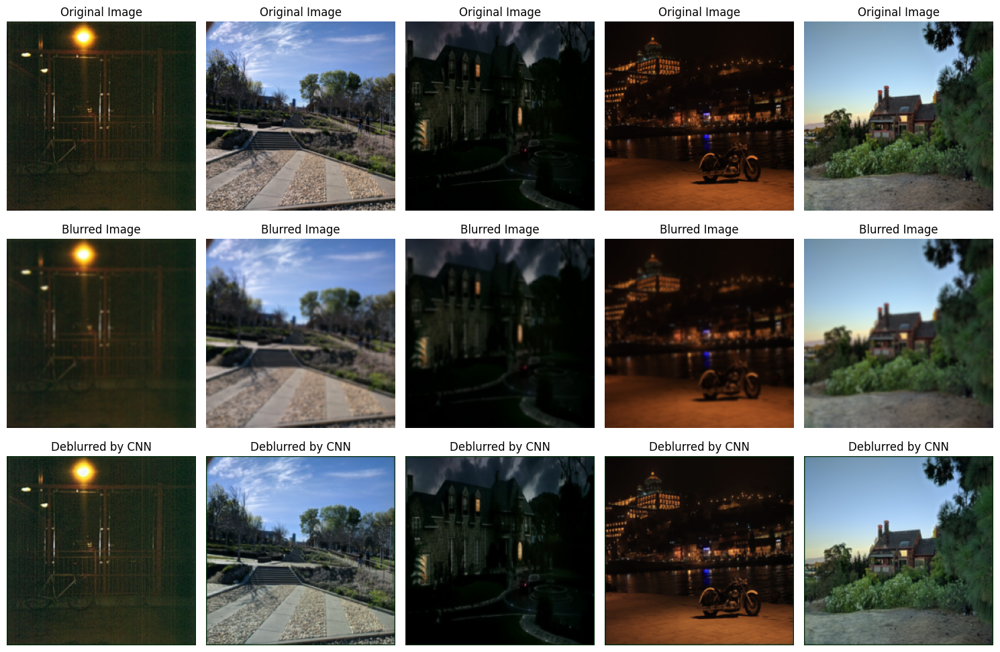

In [55]:
import matplotlib.pyplot as plt
import numpy as np

def display_samples(sample_inputs, model, device):
    model.eval()
    with torch.no_grad():
        # Moving inputs to the device
        inputs = sample_inputs.to(device)

        # Generating outputs using the trained model
        outputs = model(inputs)

        # Processing images for display
        inputs = inputs.cpu().numpy().transpose((0, 2, 3, 1))
        outputs = outputs.cpu().numpy().transpose((0, 2, 3, 1))

        fig, axs = plt.subplots(nrows=3, ncols=5, figsize=(15, 10))
        for i in range(5):
            # Original image
            axs[0, i].imshow(inputs[i])
            axs[0, i].set_title("Original Image")
            axs[0, i].axis('off')

            # Blurred image (for demonstration, applying a simple Gaussian blur)
            blurred = cv2.GaussianBlur(inputs[i], (5, 5), 0)
            axs[1, i].imshow(blurred)
            axs[1, i].set_title("Blurred Image")
            axs[1, i].axis('off')

            # Deblurred image
            axs[2, i].imshow(outputs[i])
            axs[2, i].set_title("Deblurred by CNN")
            axs[2, i].axis('off')

        for ax, row in zip(axs[:,0], ["Original", "Blurred", "Deblurred"]):
            ax.set_ylabel(row, rotation=90, size='large')

        plt.tight_layout()
        plt.show()

# Select five samples randomly from validation set for display
random_indices = np.random.choice(len(val_dataset), 5, replace=False)
sample_inputs = torch.stack([val_dataset[i][0] for i in random_indices])

# Display the samples
display_samples(sample_inputs, model, device)


100%|██████████| 63/63 [00:15<00:00,  4.17it/s]


Epoch 1, Train Loss: 0.0019662686750729955, Val Loss: 0.0015972380153095676


100%|██████████| 63/63 [00:15<00:00,  4.18it/s]


Epoch 2, Train Loss: 0.001556235373774395, Val Loss: 0.0015352221807771703


100%|██████████| 63/63 [00:15<00:00,  4.16it/s]


Epoch 3, Train Loss: 0.0017903004862749553, Val Loss: 0.0016160988889168948


100%|██████████| 63/63 [00:15<00:00,  4.17it/s]


Epoch 4, Train Loss: 0.0016251520459689423, Val Loss: 0.0015753259769611296


100%|██████████| 63/63 [00:15<00:00,  4.14it/s]


Epoch 5, Train Loss: 0.0014489903517235863, Val Loss: 0.001513431451582749


100%|██████████| 63/63 [00:15<00:00,  4.11it/s]


Epoch 6, Train Loss: 0.0014121731659001175, Val Loss: 0.0014418680618132746


100%|██████████| 63/63 [00:15<00:00,  4.15it/s]


Epoch 7, Train Loss: 0.001420096455942567, Val Loss: 0.0015465377701542502


100%|██████████| 63/63 [00:15<00:00,  4.13it/s]


Epoch 8, Train Loss: 0.0013541306001802985, Val Loss: 0.001422744854131625


100%|██████████| 63/63 [00:15<00:00,  4.13it/s]


Epoch 9, Train Loss: 0.0016831794203794066, Val Loss: 0.0020049778404571707


100%|██████████| 63/63 [00:15<00:00,  4.17it/s]


Epoch 10, Train Loss: 0.0015463539799539115, Val Loss: 0.001218771481136274


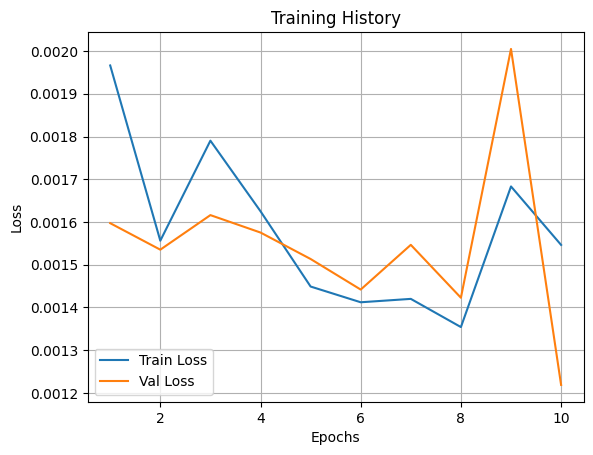

In [56]:
import matplotlib.pyplot as plt

# Define empty lists to store training and validation losses
train_losses = []
val_losses = []

# Training loop
for epoch in range(epochs):
    train_loss = train(model, train_loader)
    val_loss = validate(model, val_loader)
    print(f'Epoch {epoch+1}, Train Loss: {train_loss}, Val Loss: {val_loss}')

    # Append the losses to the lists
    train_losses.append(train_loss)
    val_losses.append(val_loss)

# Plot the training history graph
plt.plot(range(1, epochs+1), train_losses, label='Train Loss')
plt.plot(range(1, epochs+1), val_losses, label='Val Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training History')
plt.legend()
plt.grid(True)
plt.show()


In [57]:
import cv2
import numpy as np
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr

def calculate_metrics(original_images, deblurred_images):
    ssim_values = []
    psnr_values = []
    for original, deblurred in zip(original_images, deblurred_images):
        # Convert images to grayscale for SSIM calculation
        original_gray = cv2.cvtColor(original, cv2.COLOR_RGB2GRAY)
        deblurred_gray = cv2.cvtColor(deblurred, cv2.COLOR_RGB2GRAY)

        # Compute SSIM
        ssim_score = ssim(original_gray, deblurred_gray)
        ssim_values.append(ssim_score)

        # Compute PSNR
        psnr_score = psnr(original, deblurred)
        psnr_values.append(psnr_score)

    # Average SSIM and PSNR values
    avg_ssim = np.mean(ssim_values)
    avg_psnr = np.mean(psnr_values)

    return avg_ssim, avg_psnr

# Convert torch tensors to numpy arrays for calculation
original_images_np = sample_inputs.cpu().detach().numpy().transpose((0, 2, 3, 1))
deblurred_images_np = sample_outputs.cpu().detach().numpy().transpose((0, 2, 3, 1))

# Calculate SSIM and PSNR
avg_ssim, avg_psnr = calculate_metrics(original_images_np, deblurred_images_np)

print(f'Average SSIM: {avg_ssim}')
print(f'Average PSNR: {avg_psnr}')


Average SSIM: 0.4122613634069845
Average PSNR: 13.250429498226481


The Complex CNN model was able to generate images that is very close to the original ones and performed better amongst all the other models applied previously. If we look closely at the deblurred images you will notice a slight shift in colors but more or less the output looks very close the original one.